In [1]:
from __future__ import print_function
import time
import os
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torch.autograd import Variable
import matplotlib.pyplot as plt
from skimage.transform import resize

import numpy as np
from torch import nn, optim
import torch.nn.functional as F
from torchvision import datasets, transforms
from torchvision.utils import save_image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from tqdm import tqdm_notebook as tqdm

Total flower pictures available: 15740


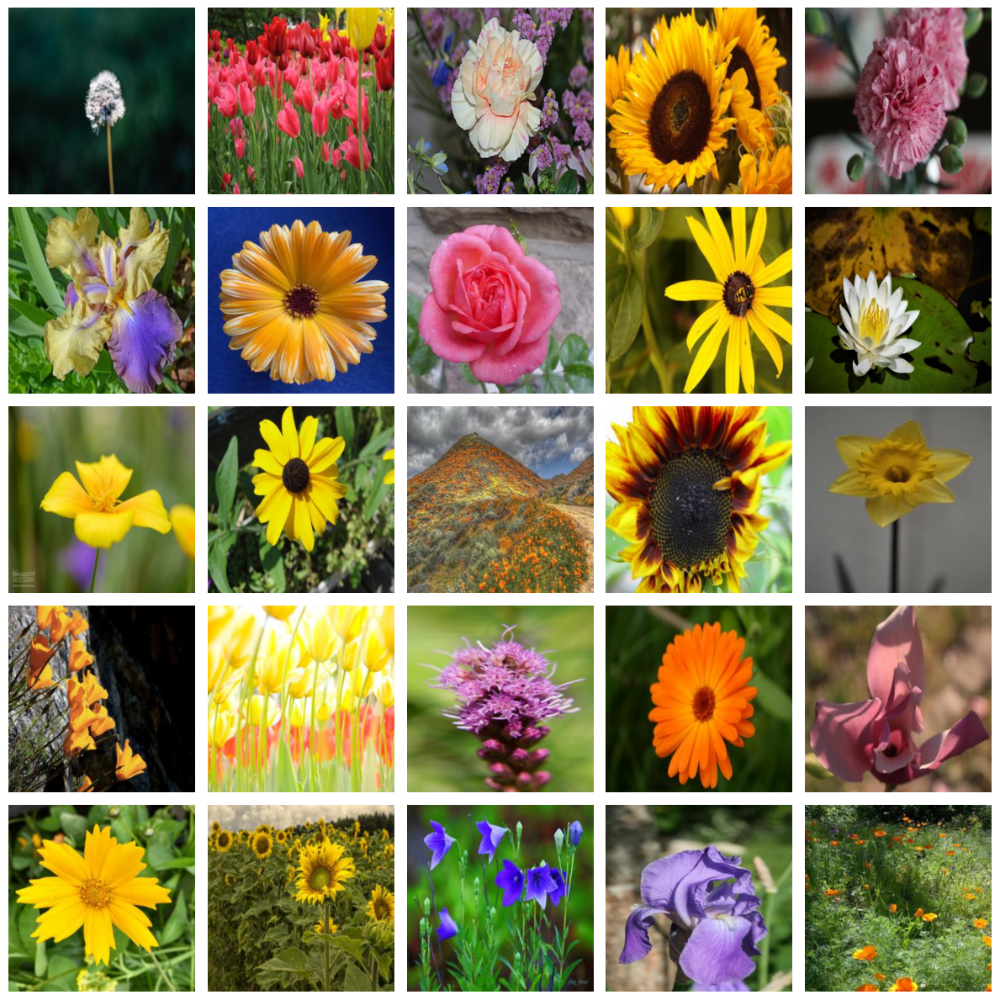

In [2]:
import os
import random
import matplotlib.pyplot as plt
from skimage.transform import resize
import numpy as np

# Define the path to the directory containing flower images
PATH = '/kaggle/input/flowers'

# Function to get all image files in the given directory
def get_image_files(directory):
    all_files = []
    for root, dirs, files in os.walk(directory):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif')):
                all_files.append(os.path.join(root, file))
    return all_files

# Get the list of all image filenames in the directory
image_files = get_image_files(PATH)

# Display the count of flower pictures in the directory
print(f'Total flower pictures available: {len(image_files)}')
# Create subplots to display random images
fig, axes = plt.subplots(nrows=5, ncols=5, figsize=(12, 12))

# Iterate through the subplots and display random flower images
for axis in axes.flatten():
    img_path = random.choice(image_files)
    
    # Load and display the image using Matplotlib
    img = plt.imread(img_path)
    
    # Resize the image to a constant size (e.g., 400x400)
    img_resized = resize(img, (400, 400))
    
    axis.imshow(img_resized)
    axis.set_axis_off()  # Turn off the axis for better visualization

plt.tight_layout()
plt.show()


In [4]:
import os
from torchvision import datasets, transforms
import torch
from PIL import Image
# Define paths
PATH = '/kaggle/input/flowers'
SAVE_PATH = '..output/preprocessed/images'

# Create directory if it does not exist
os.makedirs(SAVE_PATH, exist_ok=True)

# Define transformations
batch_size = 32
image_size = 64

random_transforms = [transforms.ColorJitter(), transforms.RandomRotation(degrees=20)]
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomApply(random_transforms, p=0.2),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

# Load dataset and create DataLoader
train_data = datasets.ImageFolder(PATH, transform=transform)
train_loader = torch.utils.data.DataLoader(train_data, shuffle=True, batch_size=batch_size)

# Iterate through DataLoader and save preprocessed images
for batch_idx, (imgs, labels) in enumerate(train_loader):
    imgs = imgs.numpy().transpose(0, 2, 3, 1)  # Convert to numpy array with shape (batch_size, height, width, channels)
    for i, img in enumerate(imgs):
        img = (img * 0.5 + 0.5) * 255  # De-normalize and scale to [0, 255]
        img = img.astype(np.uint8)
        img_pil = Image.fromarray(img)
        img_path = os.path.join(SAVE_PATH, f'preprocessed_img_{batch_idx * batch_size + i}.png')
        img_pil.save(img_path)

print(f"Preprocessed images saved to {SAVE_PATH}")

Preprocessed images saved to ..output/preprocessed/images


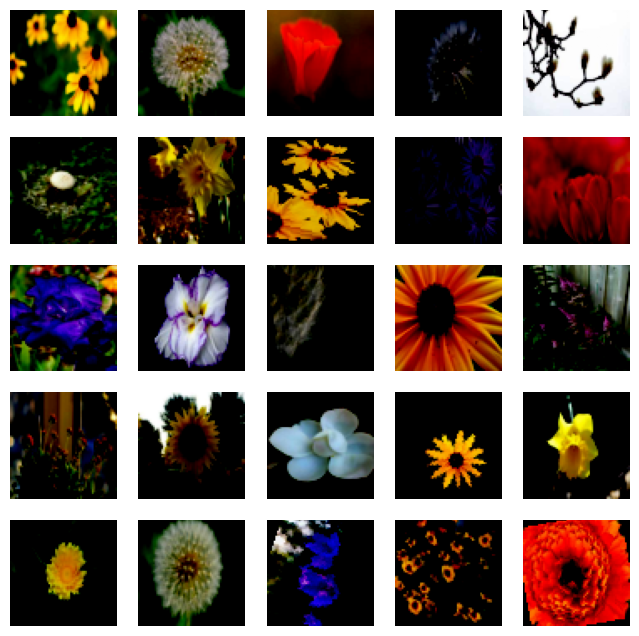

In [5]:
fig, axs = plt.subplots(5,5, figsize = (8,8))

for i in range(5):
    for j in range(5):
        axs[i,j].imshow(imgs[5*i+j])
        axs[i,j].axis('off')

plt.show()

In [6]:
def weights_init(m):
    """
    Takes as input a neural network m that will initialize all its weights.
    """
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)


In [7]:

import torch
import torch.nn as nn

class Generator(nn.Module):
    def __init__(self, nz=100, channels=3):
        super(Generator, self).__init__()
        self.nz = nz
        self.channels = channels
        
        def convlayer(n_input, n_output, k_size=4, stride=2, padding=1):
            return nn.Sequential(
                nn.ConvTranspose2d(n_input, n_output, kernel_size=k_size, stride=stride, padding=padding, bias=False),
                nn.BatchNorm2d(n_output),
                nn.ReLU(True)
            )

        self.model = nn.Sequential(
            convlayer(self.nz, 256, 4, 1, 0),   # Input: nz-dimensional noise, Output: 256 channels, 4x4 feature map
            convlayer(256, 128, 4, 2, 1),       # Input: 256 channels, Output: 128 channels, 8x8 feature map
            convlayer(128, 64, 4, 2, 1),        # Input: 128 channels, Output: 64 channels, 16x16 feature map
            convlayer(64, 32, 4, 2, 1),         # Input: 64 channels, Output: 32 channels, 32x32 feature map
            nn.ConvTranspose2d(32, self.channels, 4, 2, 1),  # Input: 32 channels, Output: channels (RGB image)
            nn.Tanh()
        )

    def forward(self, z):
        z = z.view(-1, self.nz, 1, 1)  # Reshape input noise vector
        img = self.model(z)            # Generate image from noise
        return img


In [8]:
class Discriminator(nn.Module):
    def __init__(self, channels=3):
        super(Discriminator, self).__init__()
        self.channels = channels

        def convlayer(n_input, n_output, k_size=4, stride=2, padding=1, bn=True):
            layers = [nn.Conv2d(n_input, n_output, kernel_size=k_size, stride=stride, padding=padding, bias=False)]
            if bn:
                layers.append(nn.BatchNorm2d(n_output))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *convlayer(self.channels, 32, 4, 2, 1, bn=False),   # Input: channels (RGB image), Output: 32 channels, 32x32 feature map
            *convlayer(32, 64, 4, 2, 1),       # Input: 32 channels, Output: 64 channels, 16x16 feature map
            *convlayer(64, 128, 4, 2, 1),      # Input: 64 channels, Output: 128 channels, 8x8 feature map
            *convlayer(128, 256, 4, 2, 1),     # Input: 128 channels, Output: 256 channels, 4x4 feature map
            nn.Conv2d(256, 1, 4, 1, 0, bias=False)   # Input: 256 channels, Output: 1 scalar value (probability)
        )

    def forward(self, imgs):
        logits = self.model(imgs)          # Pass images through discriminator layers
        out = torch.sigmoid(logits)        # Apply sigmoid activation for binary classification
        return out.view(-1, 1)             # Flatten output into 1D tensor

In [9]:
!mkdir results
!ls

__notebook__.ipynb  results


In [10]:
batch_size = 32
LR_G = 0.001
LR_D = 0.0005

beta1 = 0.5
epochs = 250

real_label = 0.9
fake_label = 0
nz = 128

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [11]:
netG = Generator(nz).to(device)
netD = Discriminator().to(device)

criterion = nn.BCELoss()

optimizerD = optim.Adam(netD.parameters(), lr=LR_D, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=LR_G, betas=(beta1, 0.999))

fixed_noise = torch.randn(25, nz, 1, 1, device=device)

G_losses = []
D_losses = []
epoch_time = []

In [12]:

def plot_loss (G_losses, D_losses, epoch):
    plt.figure(figsize=(10,5))
    plt.title("Generator and Discriminator Loss - EPOCH "+ str(epoch))
    plt.plot(G_losses,label="G")
    plt.plot(D_losses,label="D")
    plt.xlabel("iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()


In [13]:
def show_generated_img(n_images=5):
    sample = []
    for _ in range(n_images):
        noise = torch.randn(1, nz, 1, 1, device=device)
        gen_image = netG(noise).to("cpu").clone().detach().squeeze(0)
        gen_image = gen_image.numpy().transpose(1, 2, 0)
        sample.append(gen_image)
    
    figure, axes = plt.subplots(1, len(sample), figsize = (64,64))
    for index, axis in enumerate(axes):
        axis.axis('off')
        image_array = sample[index]
        axis.imshow(image_array)
        
    plt.show()
    plt.close()

/tmp/ipykernel_24/2539652772.py:3: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for ii, (real_images, train_labels) in enumerate(tqdm(train_loader)):


  0%|          | 0/492 [00:00<?, ?it/s]

[1/250] Loss_D: 0.8636 Loss_G: 2.4566 D(x): 0.6571 D(G(z)): 0.3184 / 0.1054


  0%|          | 0/492 [00:00<?, ?it/s]

[2/250] Loss_D: 1.0287 Loss_G: 1.4648 D(x): 0.6001 D(G(z)): 0.3501 / 0.2649


  0%|          | 0/492 [00:00<?, ?it/s]

[3/250] Loss_D: 1.1536 Loss_G: 1.8225 D(x): 0.6116 D(G(z)): 0.4176 / 0.1991


  0%|          | 0/492 [00:00<?, ?it/s]

[4/250] Loss_D: 0.9510 Loss_G: 1.6473 D(x): 0.6259 D(G(z)): 0.3363 / 0.2171


  0%|          | 0/492 [00:00<?, ?it/s]

[5/250] Loss_D: 0.7938 Loss_G: 2.6679 D(x): 0.6739 D(G(z)): 0.2986 / 0.0829


  0%|          | 0/492 [00:00<?, ?it/s]

[6/250] Loss_D: 0.9213 Loss_G: 2.4891 D(x): 0.7285 D(G(z)): 0.4057 / 0.1159


  0%|          | 0/492 [00:00<?, ?it/s]

[7/250] Loss_D: 0.5546 Loss_G: 3.5063 D(x): 0.8860 D(G(z)): 0.3045 / 0.0428


  0%|          | 0/492 [00:00<?, ?it/s]

[8/250] Loss_D: 1.2669 Loss_G: 1.1432 D(x): 0.3862 D(G(z)): 0.0770 / 0.3953


  0%|          | 0/492 [00:00<?, ?it/s]

[9/250] Loss_D: 0.7547 Loss_G: 2.4720 D(x): 0.6840 D(G(z)): 0.2489 / 0.1181


  0%|          | 0/492 [00:00<?, ?it/s]

[10/250] Loss_D: 1.0906 Loss_G: 1.2129 D(x): 0.4509 D(G(z)): 0.1270 / 0.3406


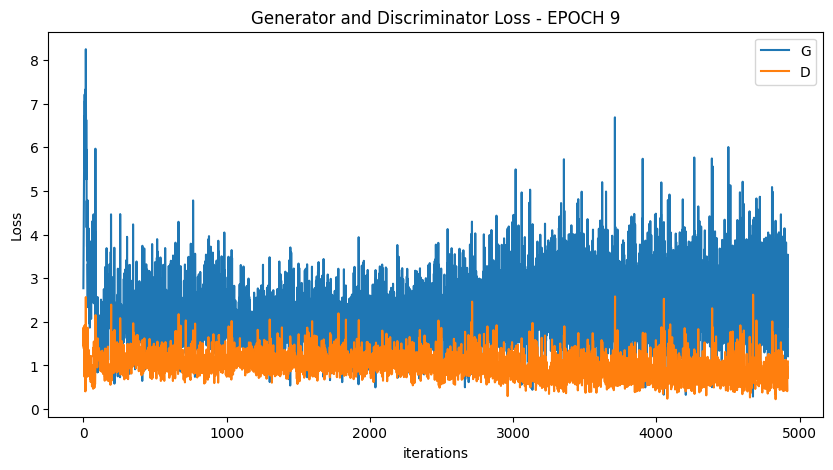

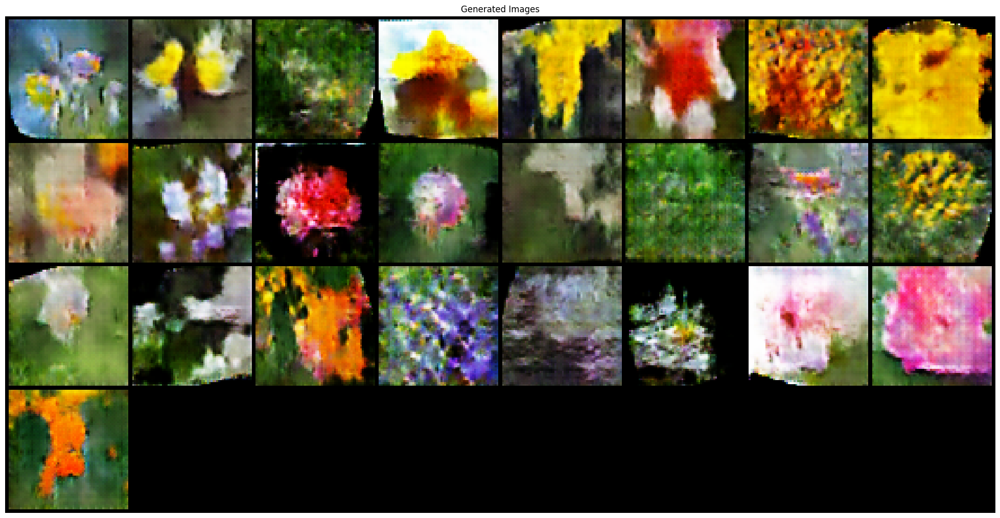

  0%|          | 0/492 [00:00<?, ?it/s]

[11/250] Loss_D: 0.4064 Loss_G: 3.1163 D(x): 0.7851 D(G(z)): 0.1300 / 0.0547


  0%|          | 0/492 [00:00<?, ?it/s]

[12/250] Loss_D: 0.4741 Loss_G: 2.4357 D(x): 0.7923 D(G(z)): 0.1909 / 0.1113


  0%|          | 0/492 [00:00<?, ?it/s]

[13/250] Loss_D: 0.3139 Loss_G: 3.5649 D(x): 0.8000 D(G(z)): 0.0727 / 0.0508


  0%|          | 0/492 [00:00<?, ?it/s]

[14/250] Loss_D: 0.8202 Loss_G: 4.9502 D(x): 0.9721 D(G(z)): 0.4528 / 0.0105


  0%|          | 0/492 [00:00<?, ?it/s]

[15/250] Loss_D: 0.4600 Loss_G: 2.8690 D(x): 0.7691 D(G(z)): 0.1385 / 0.0877


  0%|          | 0/492 [00:00<?, ?it/s]

[16/250] Loss_D: 0.4609 Loss_G: 2.3229 D(x): 0.7227 D(G(z)): 0.0757 / 0.1416


  0%|          | 0/492 [00:00<?, ?it/s]

[17/250] Loss_D: 0.7340 Loss_G: 6.8876 D(x): 0.9431 D(G(z)): 0.4095 / 0.0018


  0%|          | 0/492 [00:00<?, ?it/s]

[18/250] Loss_D: 0.5695 Loss_G: 1.5389 D(x): 0.6991 D(G(z)): 0.0973 / 0.2492


  0%|          | 0/492 [00:00<?, ?it/s]

[19/250] Loss_D: 0.2506 Loss_G: 3.5586 D(x): 0.8480 D(G(z)): 0.0615 / 0.0558


  0%|          | 0/492 [00:00<?, ?it/s]

[20/250] Loss_D: 0.4978 Loss_G: 5.4355 D(x): 0.9263 D(G(z)): 0.2986 / 0.0054


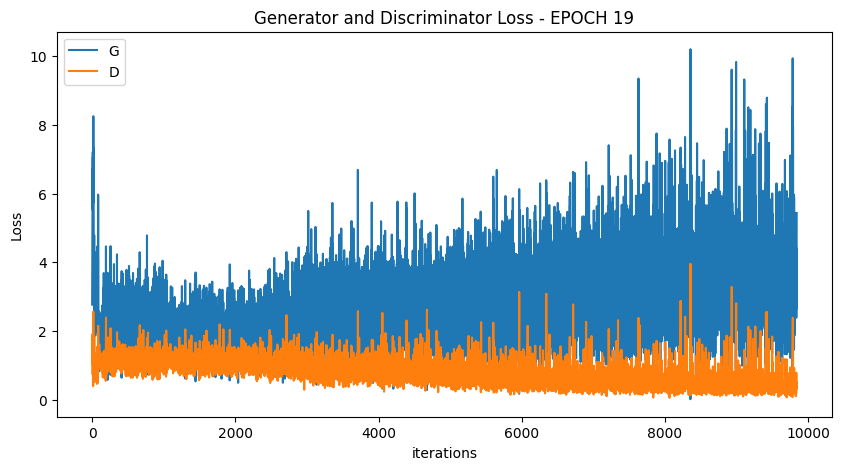

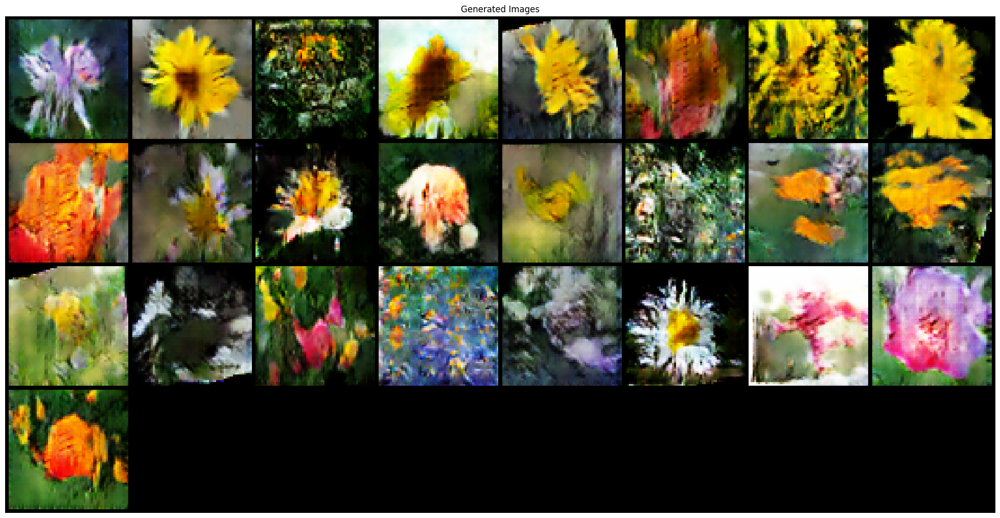

  0%|          | 0/492 [00:00<?, ?it/s]

[21/250] Loss_D: 0.4445 Loss_G: 4.7620 D(x): 0.9575 D(G(z)): 0.2734 / 0.0113


  0%|          | 0/492 [00:00<?, ?it/s]

[22/250] Loss_D: 0.2159 Loss_G: 3.5371 D(x): 0.9302 D(G(z)): 0.1235 / 0.0508


  0%|          | 0/492 [00:00<?, ?it/s]

[23/250] Loss_D: 0.2027 Loss_G: 3.3351 D(x): 0.8831 D(G(z)): 0.0534 / 0.0544


  0%|          | 0/492 [00:00<?, ?it/s]

[24/250] Loss_D: 0.1676 Loss_G: 3.4118 D(x): 0.9135 D(G(z)): 0.0635 / 0.0530


  0%|          | 0/492 [00:00<?, ?it/s]

[25/250] Loss_D: 0.5540 Loss_G: 1.6594 D(x): 0.6714 D(G(z)): 0.0194 / 0.2961


  0%|          | 0/492 [00:00<?, ?it/s]

[26/250] Loss_D: 0.4266 Loss_G: 3.1867 D(x): 0.7458 D(G(z)): 0.0480 / 0.0865


  0%|          | 0/492 [00:00<?, ?it/s]

[27/250] Loss_D: 0.2449 Loss_G: 5.5801 D(x): 0.9708 D(G(z)): 0.1409 / 0.0071


  0%|          | 0/492 [00:00<?, ?it/s]

[28/250] Loss_D: 0.1284 Loss_G: 3.7501 D(x): 0.9536 D(G(z)): 0.0725 / 0.0357


  0%|          | 0/492 [00:00<?, ?it/s]

[29/250] Loss_D: 0.7826 Loss_G: 6.6783 D(x): 0.9670 D(G(z)): 0.4073 / 0.0021


  0%|          | 0/492 [00:00<?, ?it/s]

[30/250] Loss_D: 0.3417 Loss_G: 1.5494 D(x): 0.7878 D(G(z)): 0.0550 / 0.3258


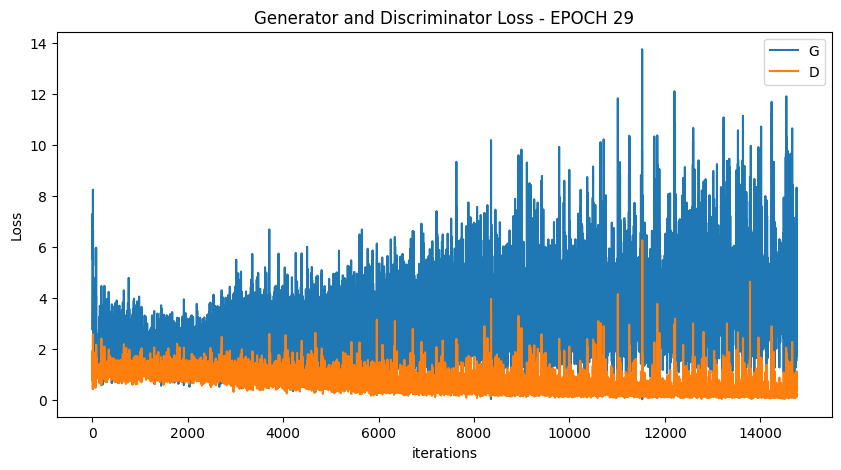

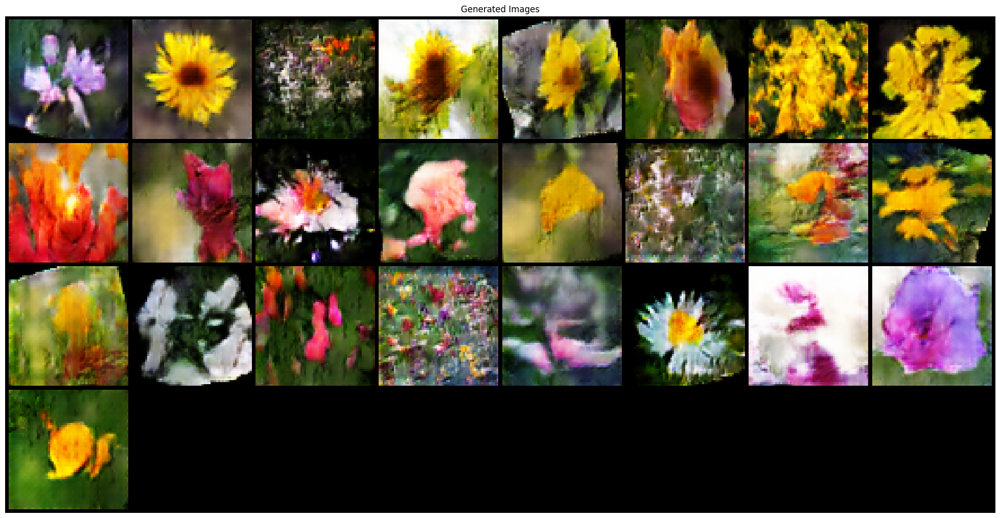

  0%|          | 0/492 [00:00<?, ?it/s]

[31/250] Loss_D: 0.2357 Loss_G: 4.9804 D(x): 0.9938 D(G(z)): 0.1701 / 0.0104


  0%|          | 0/492 [00:00<?, ?it/s]

[32/250] Loss_D: 1.0521 Loss_G: 1.8263 D(x): 0.4832 D(G(z)): 0.0065 / 0.2697


  0%|          | 0/492 [00:00<?, ?it/s]

[33/250] Loss_D: 2.3274 Loss_G: 0.4680 D(x): 0.1843 D(G(z)): 0.0011 / 0.6893


  0%|          | 0/492 [00:00<?, ?it/s]

[34/250] Loss_D: 2.8447 Loss_G: 2.7110 D(x): 0.2055 D(G(z)): 0.0028 / 0.1595


  0%|          | 0/492 [00:00<?, ?it/s]

[35/250] Loss_D: 0.0931 Loss_G: 4.9642 D(x): 0.9686 D(G(z)): 0.0521 / 0.0116


  0%|          | 0/492 [00:00<?, ?it/s]

[36/250] Loss_D: 0.1557 Loss_G: 4.9902 D(x): 0.9419 D(G(z)): 0.0739 / 0.0127


  0%|          | 0/492 [00:00<?, ?it/s]

[37/250] Loss_D: 1.2826 Loss_G: 9.6932 D(x): 0.9985 D(G(z)): 0.5862 / 0.0001


  0%|          | 0/492 [00:00<?, ?it/s]

[38/250] Loss_D: 0.2560 Loss_G: 3.7049 D(x): 0.8360 D(G(z)): 0.0104 / 0.0510


  0%|          | 0/492 [00:00<?, ?it/s]

[39/250] Loss_D: 0.1156 Loss_G: 4.6361 D(x): 0.9120 D(G(z)): 0.0105 / 0.0335


  0%|          | 0/492 [00:00<?, ?it/s]

[40/250] Loss_D: 0.2048 Loss_G: 6.3918 D(x): 0.9870 D(G(z)): 0.1471 / 0.0059


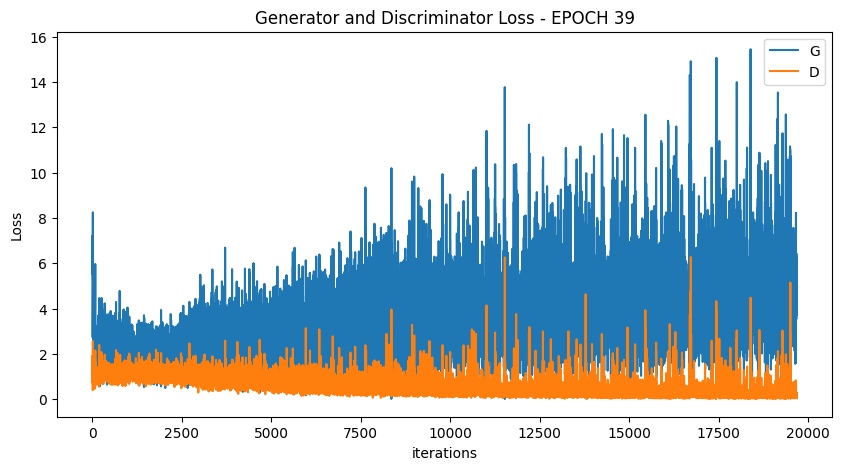

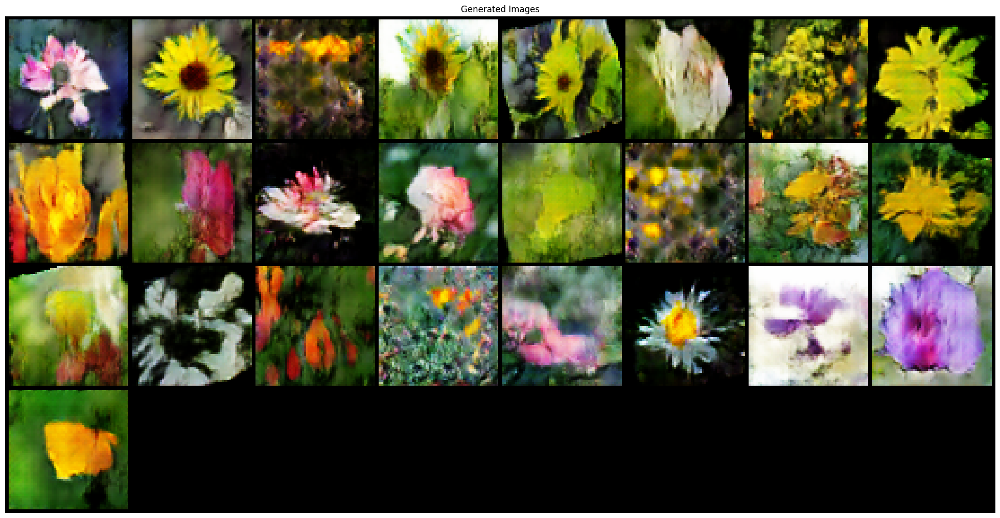

  0%|          | 0/492 [00:00<?, ?it/s]

[41/250] Loss_D: 0.0495 Loss_G: 5.0663 D(x): 0.9808 D(G(z)): 0.0277 / 0.0118


  0%|          | 0/492 [00:00<?, ?it/s]

[42/250] Loss_D: 0.0155 Loss_G: 6.1390 D(x): 0.9972 D(G(z)): 0.0125 / 0.0048


  0%|          | 0/492 [00:00<?, ?it/s]

[43/250] Loss_D: 0.1720 Loss_G: 3.4194 D(x): 0.9460 D(G(z)): 0.0916 / 0.0548


  0%|          | 0/492 [00:00<?, ?it/s]

[44/250] Loss_D: 0.2060 Loss_G: 6.3355 D(x): 0.9945 D(G(z)): 0.1563 / 0.0033


  0%|          | 0/492 [00:00<?, ?it/s]

[45/250] Loss_D: 0.5051 Loss_G: 4.6544 D(x): 0.7032 D(G(z)): 0.0123 / 0.0490


  0%|          | 0/492 [00:00<?, ?it/s]

[46/250] Loss_D: 0.4958 Loss_G: 4.2519 D(x): 0.7124 D(G(z)): 0.0090 / 0.0256


  0%|          | 0/492 [00:00<?, ?it/s]

[47/250] Loss_D: 0.4161 Loss_G: 5.8354 D(x): 0.9892 D(G(z)): 0.2846 / 0.0038


  0%|          | 0/492 [00:00<?, ?it/s]

[48/250] Loss_D: 0.3245 Loss_G: 3.1901 D(x): 0.8183 D(G(z)): 0.0731 / 0.0855


  0%|          | 0/492 [00:00<?, ?it/s]

[49/250] Loss_D: 0.2237 Loss_G: 4.9495 D(x): 0.9844 D(G(z)): 0.1569 / 0.0156


  0%|          | 0/492 [00:00<?, ?it/s]

[50/250] Loss_D: 0.1491 Loss_G: 5.4938 D(x): 0.8911 D(G(z)): 0.0058 / 0.0127


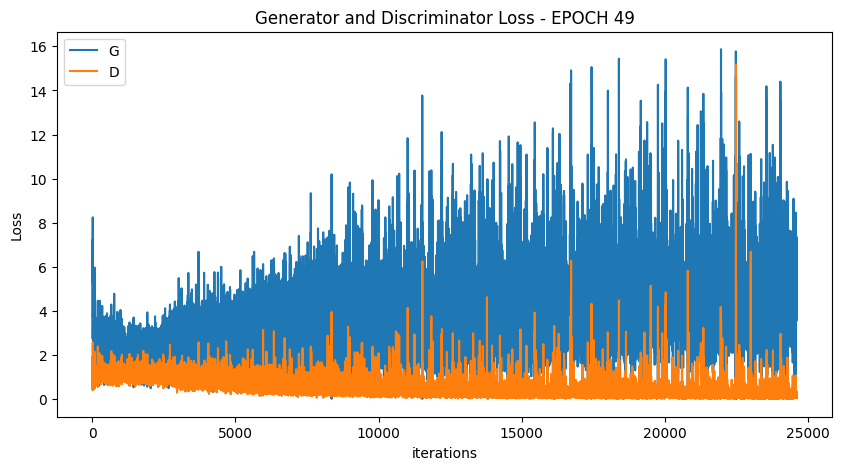

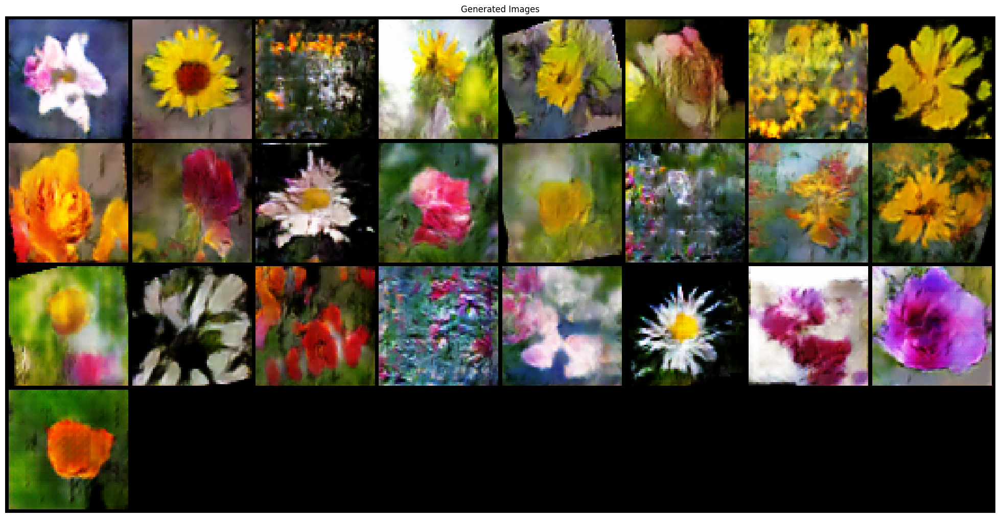

  0%|          | 0/492 [00:00<?, ?it/s]

[51/250] Loss_D: 0.3860 Loss_G: 6.8621 D(x): 0.9932 D(G(z)): 0.2485 / 0.0018


  0%|          | 0/492 [00:00<?, ?it/s]

[52/250] Loss_D: 0.1269 Loss_G: 5.2199 D(x): 0.9685 D(G(z)): 0.0817 / 0.0114


  0%|          | 0/492 [00:00<?, ?it/s]

[53/250] Loss_D: 0.0997 Loss_G: 2.2300 D(x): 0.9570 D(G(z)): 0.0388 / 0.2425


  0%|          | 0/492 [00:00<?, ?it/s]

[54/250] Loss_D: 0.0555 Loss_G: 6.4558 D(x): 0.9715 D(G(z)): 0.0240 / 0.0031


  0%|          | 0/492 [00:00<?, ?it/s]

[55/250] Loss_D: 0.1388 Loss_G: 4.4178 D(x): 0.9511 D(G(z)): 0.0236 / 0.0244


  0%|          | 0/492 [00:00<?, ?it/s]

[56/250] Loss_D: 0.2336 Loss_G: 3.4517 D(x): 0.8592 D(G(z)): 0.0518 / 0.0551


  0%|          | 0/492 [00:00<?, ?it/s]

[57/250] Loss_D: 0.4257 Loss_G: 8.0134 D(x): 0.9574 D(G(z)): 0.2450 / 0.0008


  0%|          | 0/492 [00:00<?, ?it/s]

[58/250] Loss_D: 0.1542 Loss_G: 4.9366 D(x): 0.8905 D(G(z)): 0.0153 / 0.0246


  0%|          | 0/492 [00:00<?, ?it/s]

[59/250] Loss_D: 0.0805 Loss_G: 3.3072 D(x): 0.9707 D(G(z)): 0.0442 / 0.0634


  0%|          | 0/492 [00:00<?, ?it/s]

[60/250] Loss_D: 0.2755 Loss_G: 3.4711 D(x): 0.9072 D(G(z)): 0.1408 / 0.0538


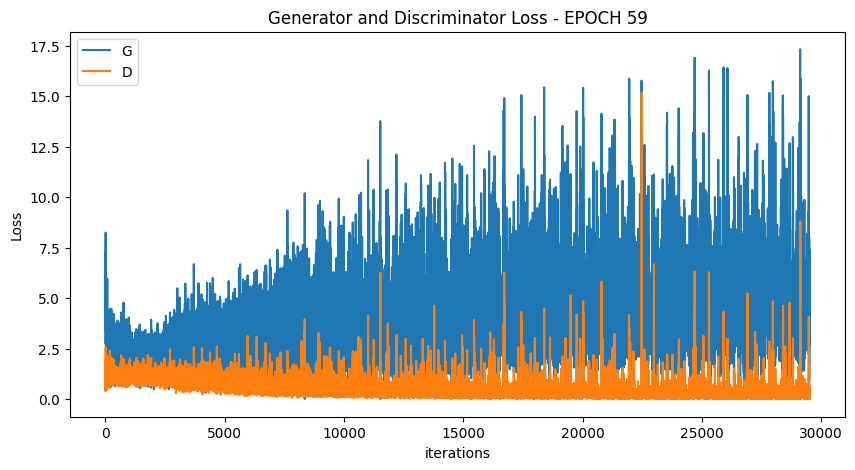

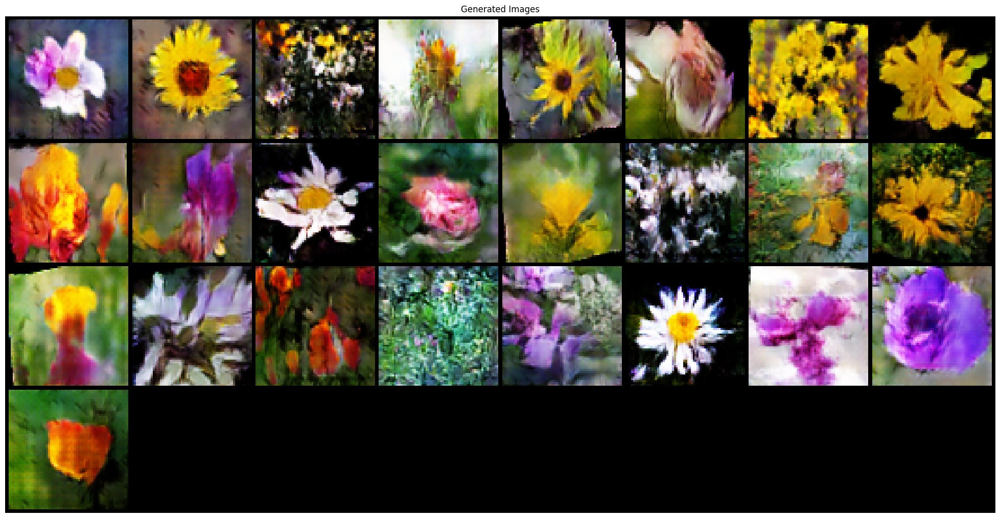

  0%|          | 0/492 [00:00<?, ?it/s]

[61/250] Loss_D: 0.2789 Loss_G: 5.0799 D(x): 0.8225 D(G(z)): 0.0034 / 0.0140


  0%|          | 0/492 [00:00<?, ?it/s]

[62/250] Loss_D: 0.3745 Loss_G: 3.6571 D(x): 0.7625 D(G(z)): 0.0059 / 0.0554


  0%|          | 0/492 [00:00<?, ?it/s]

[63/250] Loss_D: 0.1145 Loss_G: 5.9601 D(x): 0.9178 D(G(z)): 0.0092 / 0.0068


  0%|          | 0/492 [00:00<?, ?it/s]

[64/250] Loss_D: 0.2537 Loss_G: 5.3329 D(x): 0.8470 D(G(z)): 0.0154 / 0.0210


  0%|          | 0/492 [00:00<?, ?it/s]

[65/250] Loss_D: 0.0467 Loss_G: 9.5070 D(x): 0.9671 D(G(z)): 0.0093 / 0.0007


  0%|          | 0/492 [00:00<?, ?it/s]

[66/250] Loss_D: 0.1273 Loss_G: 4.5316 D(x): 0.9931 D(G(z)): 0.1006 / 0.0220


  0%|          | 0/492 [00:00<?, ?it/s]

[67/250] Loss_D: 0.2424 Loss_G: 6.2029 D(x): 0.9970 D(G(z)): 0.1602 / 0.0035


  0%|          | 0/492 [00:00<?, ?it/s]

[68/250] Loss_D: 0.1530 Loss_G: 4.8132 D(x): 0.9298 D(G(z)): 0.0587 / 0.0122


  0%|          | 0/492 [00:00<?, ?it/s]

[69/250] Loss_D: 0.0609 Loss_G: 3.7667 D(x): 0.9998 D(G(z)): 0.0552 / 0.0494


  0%|          | 0/492 [00:00<?, ?it/s]

[70/250] Loss_D: 0.6441 Loss_G: 8.4082 D(x): 0.9724 D(G(z)): 0.3664 / 0.0006


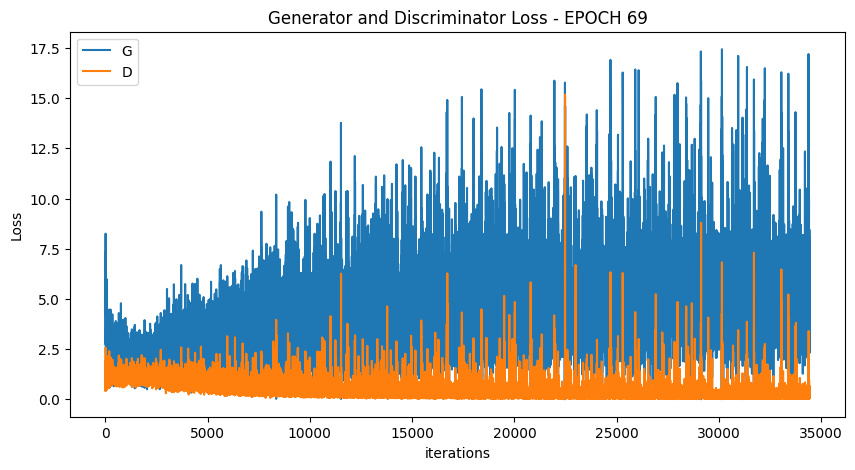

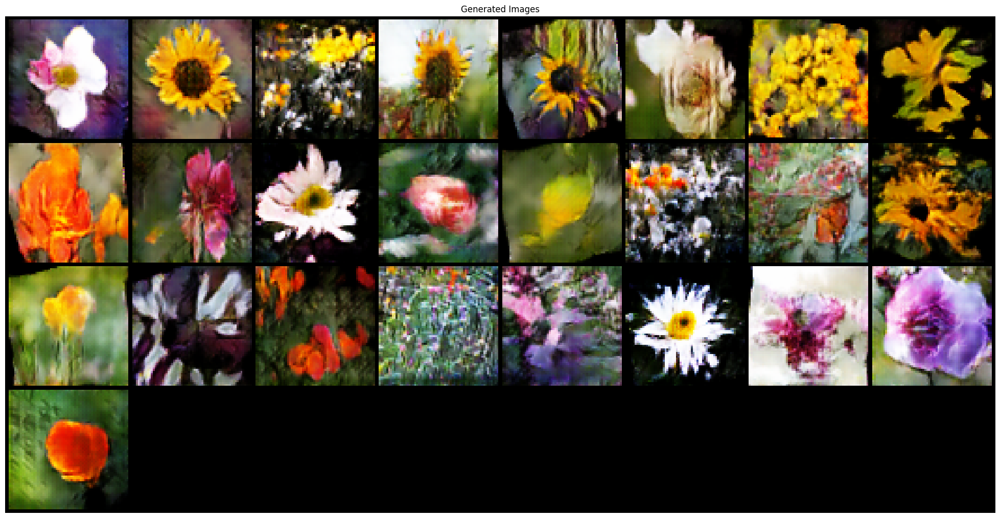

  0%|          | 0/492 [00:00<?, ?it/s]

[71/250] Loss_D: 0.0485 Loss_G: 4.4097 D(x): 0.9887 D(G(z)): 0.0345 / 0.0276


  0%|          | 0/492 [00:00<?, ?it/s]

[72/250] Loss_D: 0.1704 Loss_G: 5.6637 D(x): 0.9864 D(G(z)): 0.1278 / 0.0049


  0%|          | 0/492 [00:00<?, ?it/s]

[73/250] Loss_D: 0.0433 Loss_G: 6.1388 D(x): 0.9985 D(G(z)): 0.0392 / 0.0046


  0%|          | 0/492 [00:00<?, ?it/s]

[74/250] Loss_D: 0.2418 Loss_G: 3.0150 D(x): 0.8567 D(G(z)): 0.0472 / 0.0847


  0%|          | 0/492 [00:00<?, ?it/s]

[75/250] Loss_D: 0.0626 Loss_G: 3.9429 D(x): 0.9760 D(G(z)): 0.0355 / 0.0348


  0%|          | 0/492 [00:00<?, ?it/s]

[76/250] Loss_D: 0.0145 Loss_G: 7.5344 D(x): 0.9893 D(G(z)): 0.0036 / 0.0016


  0%|          | 0/492 [00:00<?, ?it/s]

[77/250] Loss_D: 0.0476 Loss_G: 5.2043 D(x): 0.9808 D(G(z)): 0.0245 / 0.0157


  0%|          | 0/492 [00:00<?, ?it/s]

[78/250] Loss_D: 0.1109 Loss_G: 5.7416 D(x): 0.9345 D(G(z)): 0.0337 / 0.0108


  0%|          | 0/492 [00:00<?, ?it/s]

[79/250] Loss_D: 0.4006 Loss_G: 2.5009 D(x): 0.8156 D(G(z)): 0.0716 / 0.1307


  0%|          | 0/492 [00:00<?, ?it/s]

[80/250] Loss_D: 0.1189 Loss_G: 5.6857 D(x): 0.9749 D(G(z)): 0.0818 / 0.0080


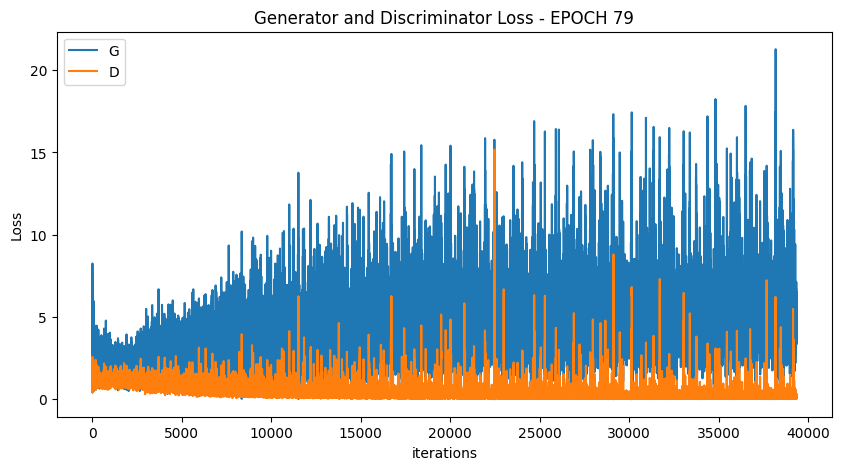

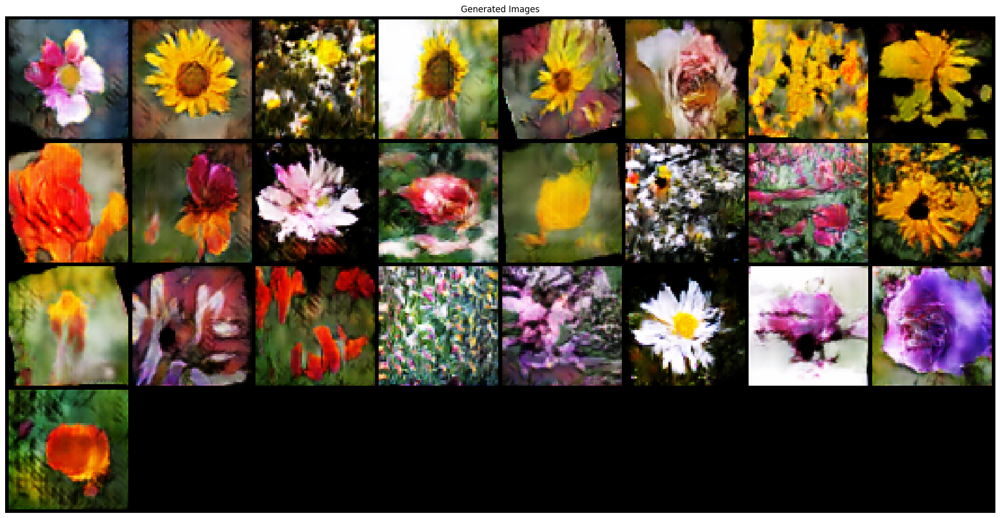

  0%|          | 0/492 [00:00<?, ?it/s]

[81/250] Loss_D: 0.0238 Loss_G: 8.2107 D(x): 0.9818 D(G(z)): 0.0052 / 0.0010


  0%|          | 0/492 [00:00<?, ?it/s]

[82/250] Loss_D: 0.0539 Loss_G: 5.0588 D(x): 0.9956 D(G(z)): 0.0454 / 0.0136


  0%|          | 0/492 [00:00<?, ?it/s]

[83/250] Loss_D: 0.1015 Loss_G: 4.4441 D(x): 0.9400 D(G(z)): 0.0317 / 0.0254


  0%|          | 0/492 [00:00<?, ?it/s]

[84/250] Loss_D: 0.0434 Loss_G: 4.1816 D(x): 0.9851 D(G(z)): 0.0261 / 0.0389


  0%|          | 0/492 [00:00<?, ?it/s]

[85/250] Loss_D: 0.0142 Loss_G: 8.5472 D(x): 0.9943 D(G(z)): 0.0083 / 0.0007


  0%|          | 0/492 [00:00<?, ?it/s]

[86/250] Loss_D: 0.5124 Loss_G: 2.3154 D(x): 0.7066 D(G(z)): 0.0144 / 0.2427


  0%|          | 0/492 [00:00<?, ?it/s]

[87/250] Loss_D: 0.4366 Loss_G: 2.7873 D(x): 0.7220 D(G(z)): 0.0177 / 0.1421


  0%|          | 0/492 [00:00<?, ?it/s]

[88/250] Loss_D: 0.1187 Loss_G: 5.4148 D(x): 0.9575 D(G(z)): 0.0581 / 0.0067


  0%|          | 0/492 [00:00<?, ?it/s]

[89/250] Loss_D: 0.0266 Loss_G: 8.2941 D(x): 0.9931 D(G(z)): 0.0174 / 0.0011


  0%|          | 0/492 [00:00<?, ?it/s]

[90/250] Loss_D: 0.1089 Loss_G: 8.6424 D(x): 0.9623 D(G(z)): 0.0542 / 0.0012


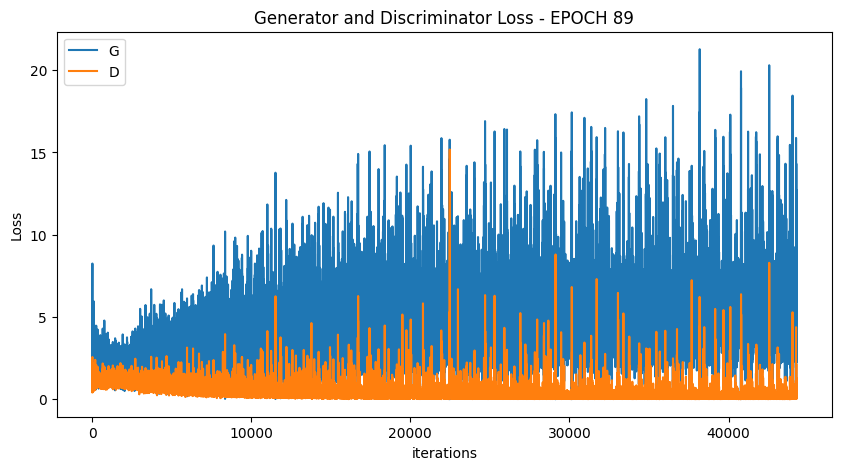

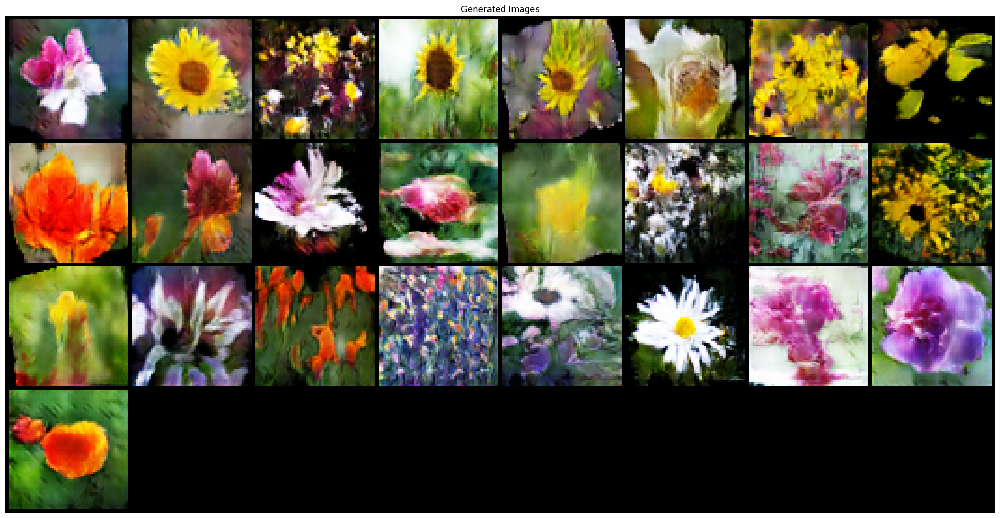

  0%|          | 0/492 [00:00<?, ?it/s]

[91/250] Loss_D: 0.2970 Loss_G: 4.2504 D(x): 0.9292 D(G(z)): 0.1572 / 0.0251


  0%|          | 0/492 [00:00<?, ?it/s]

[92/250] Loss_D: 0.6599 Loss_G: 11.5389 D(x): 0.9943 D(G(z)): 0.3322 / 0.0000


  0%|          | 0/492 [00:00<?, ?it/s]

[93/250] Loss_D: 0.0837 Loss_G: 6.2676 D(x): 0.9821 D(G(z)): 0.0472 / 0.0064


  0%|          | 0/492 [00:00<?, ?it/s]

[94/250] Loss_D: 0.2691 Loss_G: 4.2477 D(x): 0.9011 D(G(z)): 0.1214 / 0.0317


  0%|          | 0/492 [00:00<?, ?it/s]

[95/250] Loss_D: 0.0616 Loss_G: 5.5231 D(x): 0.9754 D(G(z)): 0.0335 / 0.0142


  0%|          | 0/492 [00:00<?, ?it/s]

[96/250] Loss_D: 0.0549 Loss_G: 5.8096 D(x): 0.9740 D(G(z)): 0.0242 / 0.0078


  0%|          | 0/492 [00:00<?, ?it/s]

[97/250] Loss_D: 0.0422 Loss_G: 7.0608 D(x): 0.9741 D(G(z)): 0.0142 / 0.0031


  0%|          | 0/492 [00:00<?, ?it/s]

[98/250] Loss_D: 0.0159 Loss_G: 6.4616 D(x): 0.9862 D(G(z)): 0.0018 / 0.0032


  0%|          | 0/492 [00:00<?, ?it/s]

[99/250] Loss_D: 0.1201 Loss_G: 8.1239 D(x): 0.9833 D(G(z)): 0.0883 / 0.0008


  0%|          | 0/492 [00:00<?, ?it/s]

[100/250] Loss_D: 0.1899 Loss_G: 3.5587 D(x): 0.9043 D(G(z)): 0.0522 / 0.0509


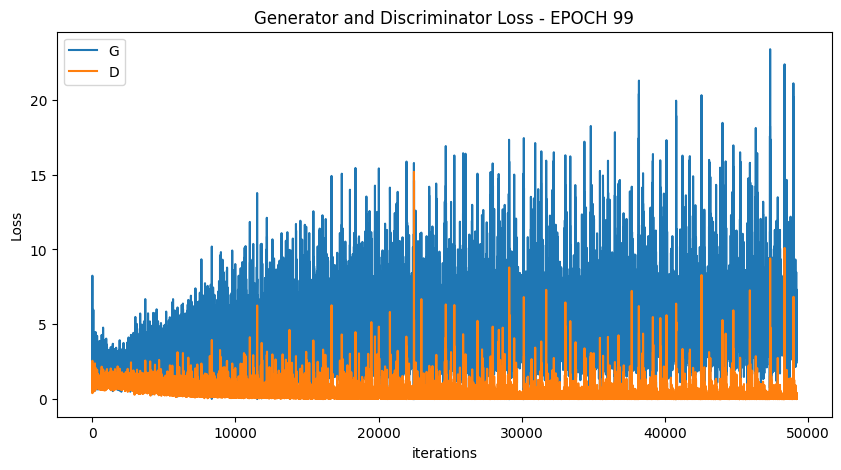

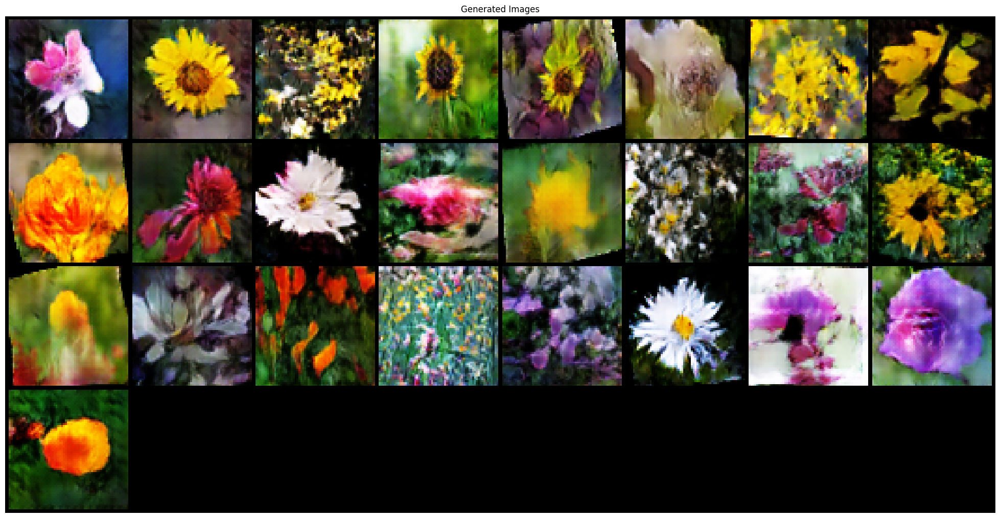

  0%|          | 0/492 [00:00<?, ?it/s]

[101/250] Loss_D: 0.2389 Loss_G: 6.3637 D(x): 0.9462 D(G(z)): 0.1200 / 0.0043


  0%|          | 0/492 [00:00<?, ?it/s]

[102/250] Loss_D: 0.0464 Loss_G: 5.9827 D(x): 0.9977 D(G(z)): 0.0324 / 0.0067


  0%|          | 0/492 [00:00<?, ?it/s]

[103/250] Loss_D: 0.0182 Loss_G: 5.4451 D(x): 0.9989 D(G(z)): 0.0167 / 0.0094


  0%|          | 0/492 [00:00<?, ?it/s]

[104/250] Loss_D: 0.7561 Loss_G: 1.4749 D(x): 0.6376 D(G(z)): 0.0623 / 0.3648


  0%|          | 0/492 [00:00<?, ?it/s]

[105/250] Loss_D: 0.0390 Loss_G: 5.2373 D(x): 0.9981 D(G(z)): 0.0353 / 0.0122


  0%|          | 0/492 [00:00<?, ?it/s]

[106/250] Loss_D: 0.1459 Loss_G: 5.2993 D(x): 0.8801 D(G(z)): 0.0081 / 0.0230


  0%|          | 0/492 [00:00<?, ?it/s]

[107/250] Loss_D: 1.3801 Loss_G: 1.6155 D(x): 0.4039 D(G(z)): 0.0023 / 0.4204


  0%|          | 0/492 [00:00<?, ?it/s]

[108/250] Loss_D: 0.3578 Loss_G: 5.8312 D(x): 0.9966 D(G(z)): 0.1551 / 0.0075


  0%|          | 0/492 [00:00<?, ?it/s]

[109/250] Loss_D: 0.0450 Loss_G: 6.8961 D(x): 0.9638 D(G(z)): 0.0030 / 0.0032


  0%|          | 0/492 [00:00<?, ?it/s]

[110/250] Loss_D: 0.0588 Loss_G: 7.1827 D(x): 0.9748 D(G(z)): 0.0276 / 0.0030


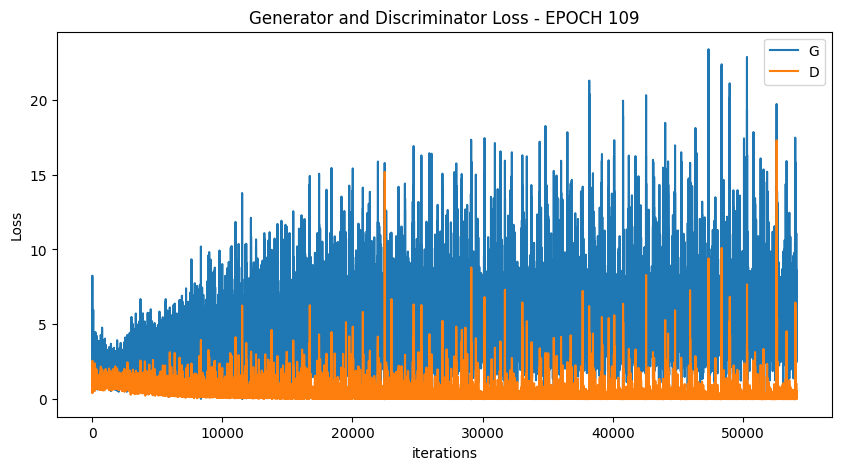

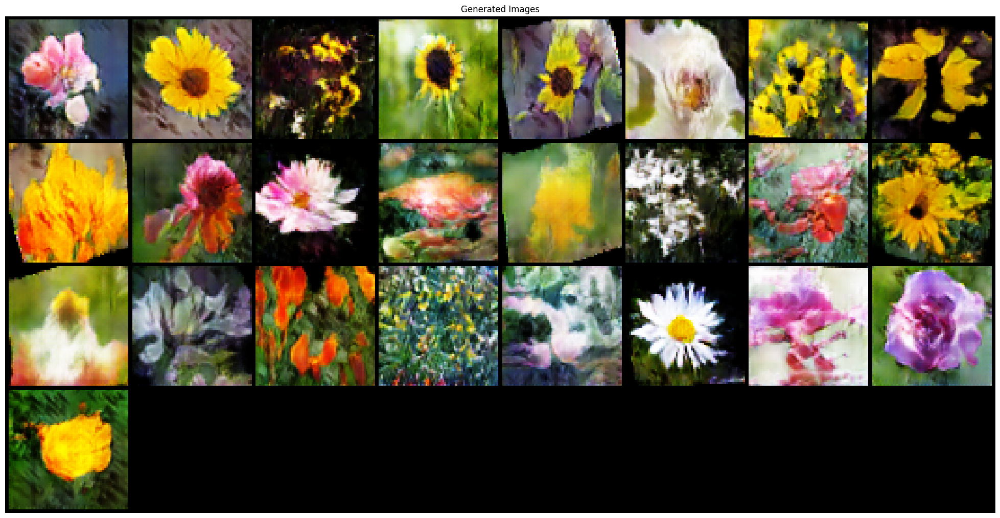

  0%|          | 0/492 [00:00<?, ?it/s]

[111/250] Loss_D: 0.0170 Loss_G: 6.5269 D(x): 0.9927 D(G(z)): 0.0094 / 0.0047


  0%|          | 0/492 [00:00<?, ?it/s]

[112/250] Loss_D: 0.5591 Loss_G: 8.9866 D(x): 0.9955 D(G(z)): 0.3248 / 0.0003


  0%|          | 0/492 [00:00<?, ?it/s]

[113/250] Loss_D: 0.0847 Loss_G: 4.3092 D(x): 0.9781 D(G(z)): 0.0542 / 0.0297


  0%|          | 0/492 [00:00<?, ?it/s]

[114/250] Loss_D: 0.1849 Loss_G: 5.2997 D(x): 0.9176 D(G(z)): 0.0395 / 0.0147


  0%|          | 0/492 [00:00<?, ?it/s]

[115/250] Loss_D: 0.0754 Loss_G: 5.0574 D(x): 0.9434 D(G(z)): 0.0138 / 0.0154


  0%|          | 0/492 [00:00<?, ?it/s]

[116/250] Loss_D: 0.1709 Loss_G: 6.4506 D(x): 0.9999 D(G(z)): 0.1250 / 0.0034


  0%|          | 0/492 [00:00<?, ?it/s]

[117/250] Loss_D: 0.2954 Loss_G: 6.3934 D(x): 0.8295 D(G(z)): 0.0122 / 0.0084


  0%|          | 0/492 [00:00<?, ?it/s]

[118/250] Loss_D: 0.1437 Loss_G: 4.9012 D(x): 0.9993 D(G(z)): 0.1178 / 0.0135


  0%|          | 0/492 [00:00<?, ?it/s]

[119/250] Loss_D: 0.0358 Loss_G: 6.1872 D(x): 0.9925 D(G(z)): 0.0260 / 0.0078


  0%|          | 0/492 [00:00<?, ?it/s]

[120/250] Loss_D: 0.0899 Loss_G: 4.9270 D(x): 0.9700 D(G(z)): 0.0460 / 0.0134


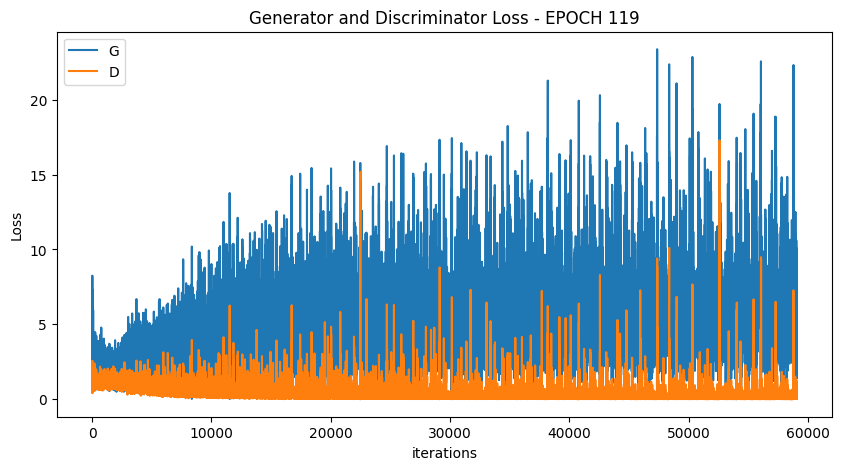

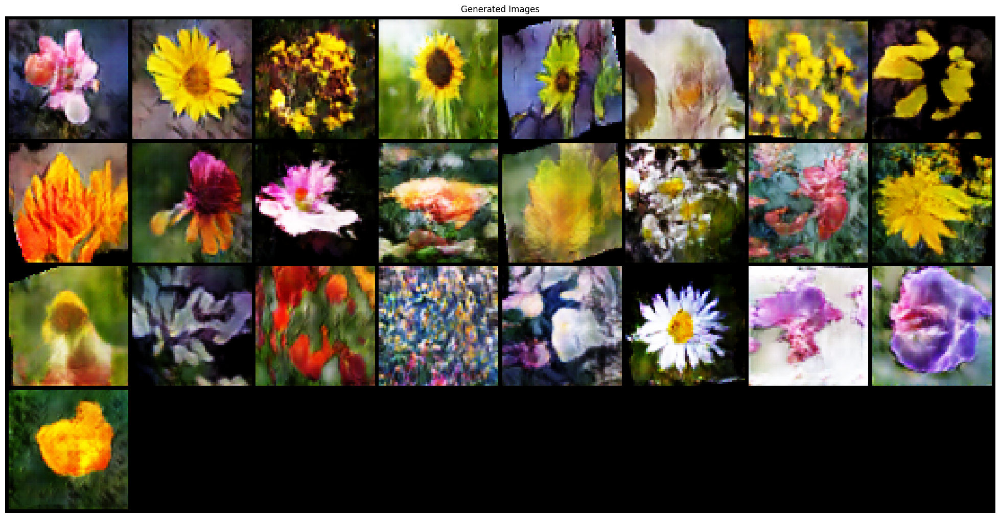

  0%|          | 0/492 [00:00<?, ?it/s]

[121/250] Loss_D: 0.1039 Loss_G: 5.8573 D(x): 0.9485 D(G(z)): 0.0435 / 0.0098


  0%|          | 0/492 [00:00<?, ?it/s]

[122/250] Loss_D: 0.1070 Loss_G: 5.2293 D(x): 0.9247 D(G(z)): 0.0075 / 0.0176


  0%|          | 0/492 [00:00<?, ?it/s]

[123/250] Loss_D: 0.0136 Loss_G: 7.1737 D(x): 0.9943 D(G(z)): 0.0073 / 0.0049


  0%|          | 0/492 [00:00<?, ?it/s]

[124/250] Loss_D: 0.2683 Loss_G: 5.0973 D(x): 0.8884 D(G(z)): 0.0817 / 0.0144


  0%|          | 0/492 [00:00<?, ?it/s]

[125/250] Loss_D: 0.0307 Loss_G: 7.0325 D(x): 0.9745 D(G(z)): 0.0037 / 0.0030


  0%|          | 0/492 [00:00<?, ?it/s]

[126/250] Loss_D: 0.0757 Loss_G: 6.4328 D(x): 0.9967 D(G(z)): 0.0652 / 0.0062


  0%|          | 0/492 [00:00<?, ?it/s]

[127/250] Loss_D: 0.0381 Loss_G: 6.5595 D(x): 0.9866 D(G(z)): 0.0233 / 0.0035


  0%|          | 0/492 [00:00<?, ?it/s]

[128/250] Loss_D: 0.1428 Loss_G: 6.4614 D(x): 0.8839 D(G(z)): 0.0020 / 0.0061


  0%|          | 0/492 [00:00<?, ?it/s]

[129/250] Loss_D: 0.0842 Loss_G: 5.3942 D(x): 0.9977 D(G(z)): 0.0652 / 0.0080


  0%|          | 0/492 [00:00<?, ?it/s]

[130/250] Loss_D: 0.8952 Loss_G: 0.8358 D(x): 0.5270 D(G(z)): 0.0032 / 0.5237


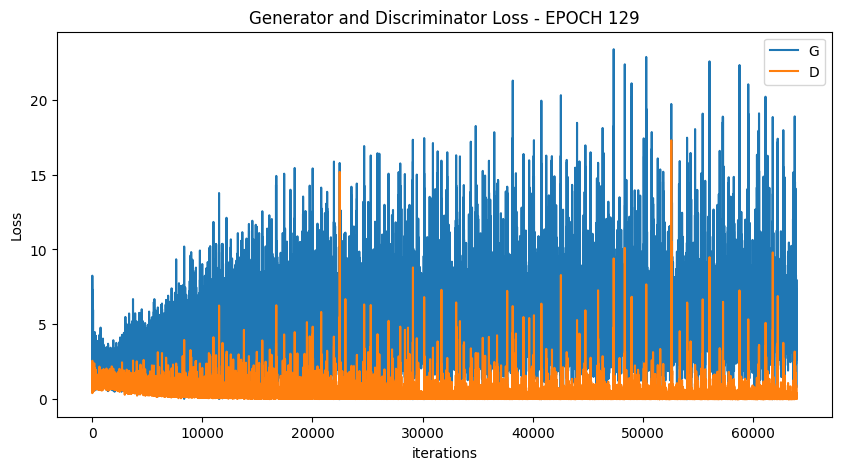

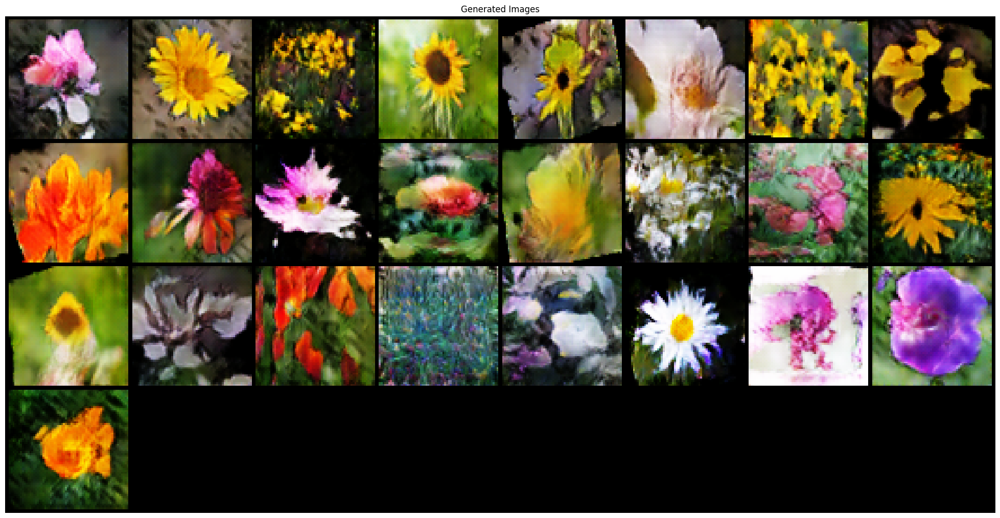

  0%|          | 0/492 [00:00<?, ?it/s]

[131/250] Loss_D: 0.1863 Loss_G: 6.4386 D(x): 0.9910 D(G(z)): 0.1440 / 0.0028


  0%|          | 0/492 [00:00<?, ?it/s]

[132/250] Loss_D: 0.0328 Loss_G: 7.6882 D(x): 0.9846 D(G(z)): 0.0163 / 0.0019


  0%|          | 0/492 [00:00<?, ?it/s]

[133/250] Loss_D: 0.0568 Loss_G: 5.6291 D(x): 0.9564 D(G(z)): 0.0064 / 0.0157


  0%|          | 0/492 [00:00<?, ?it/s]

[134/250] Loss_D: 0.0578 Loss_G: 4.9885 D(x): 0.9741 D(G(z)): 0.0288 / 0.0192


  0%|          | 0/492 [00:00<?, ?it/s]

[135/250] Loss_D: 0.0330 Loss_G: 9.9645 D(x): 0.9727 D(G(z)): 0.0004 / 0.0004


  0%|          | 0/492 [00:00<?, ?it/s]

[136/250] Loss_D: 0.0103 Loss_G: 6.4165 D(x): 0.9977 D(G(z)): 0.0078 / 0.0108


  0%|          | 0/492 [00:00<?, ?it/s]

[137/250] Loss_D: 0.0323 Loss_G: 5.7814 D(x): 0.9799 D(G(z)): 0.0112 / 0.0122


  0%|          | 0/492 [00:00<?, ?it/s]

[138/250] Loss_D: 0.0188 Loss_G: 7.1543 D(x): 0.9846 D(G(z)): 0.0027 / 0.0023


  0%|          | 0/492 [00:00<?, ?it/s]

[139/250] Loss_D: 0.1012 Loss_G: 5.2443 D(x): 0.9333 D(G(z)): 0.0034 / 0.0120


  0%|          | 0/492 [00:00<?, ?it/s]

[140/250] Loss_D: 0.0188 Loss_G: 6.1621 D(x): 0.9972 D(G(z)): 0.0155 / 0.0050


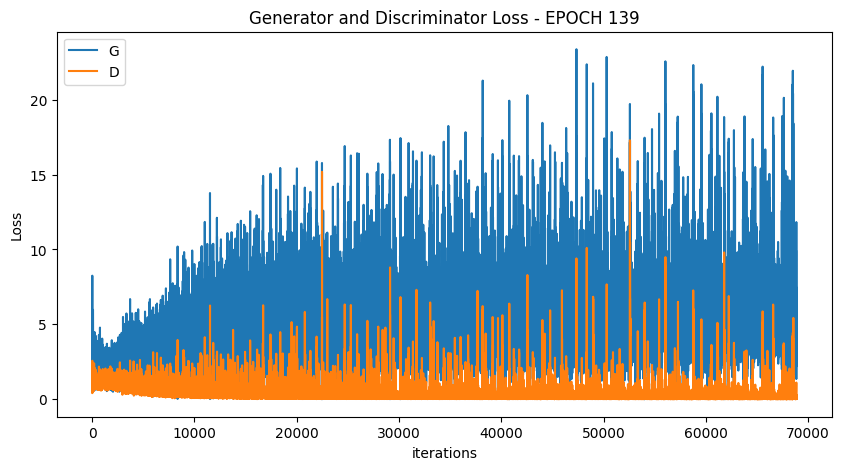

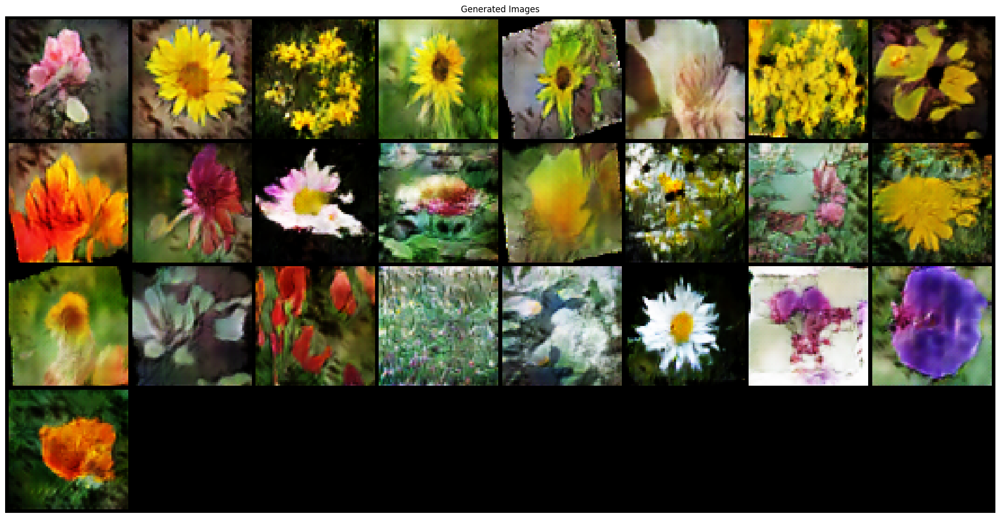

  0%|          | 0/492 [00:00<?, ?it/s]

[141/250] Loss_D: 0.0388 Loss_G: 5.8612 D(x): 0.9920 D(G(z)): 0.0289 / 0.0080


  0%|          | 0/492 [00:00<?, ?it/s]

[142/250] Loss_D: 0.0599 Loss_G: 8.1614 D(x): 0.9457 D(G(z)): 0.0014 / 0.0011


  0%|          | 0/492 [00:00<?, ?it/s]

[143/250] Loss_D: 0.1522 Loss_G: 6.9924 D(x): 0.9981 D(G(z)): 0.0823 / 0.0037


  0%|          | 0/492 [00:00<?, ?it/s]

[144/250] Loss_D: 0.0817 Loss_G: 5.6731 D(x): 0.9701 D(G(z)): 0.0402 / 0.0095


  0%|          | 0/492 [00:00<?, ?it/s]

[145/250] Loss_D: 0.3822 Loss_G: 6.5732 D(x): 0.9999 D(G(z)): 0.2538 / 0.0022


  0%|          | 0/492 [00:00<?, ?it/s]

[146/250] Loss_D: 0.1419 Loss_G: 4.8198 D(x): 0.9066 D(G(z)): 0.0151 / 0.0212


  0%|          | 0/492 [00:00<?, ?it/s]

[147/250] Loss_D: 0.1062 Loss_G: 5.6891 D(x): 0.9858 D(G(z)): 0.0728 / 0.0083


  0%|          | 0/492 [00:00<?, ?it/s]

[148/250] Loss_D: 0.1233 Loss_G: 7.7513 D(x): 0.9946 D(G(z)): 0.0949 / 0.0014


  0%|          | 0/492 [00:00<?, ?it/s]

[149/250] Loss_D: 0.0056 Loss_G: 8.9358 D(x): 0.9955 D(G(z)): 0.0011 / 0.0005


  0%|          | 0/492 [00:00<?, ?it/s]

[150/250] Loss_D: 0.0389 Loss_G: 6.1003 D(x): 0.9758 D(G(z)): 0.0128 / 0.0088


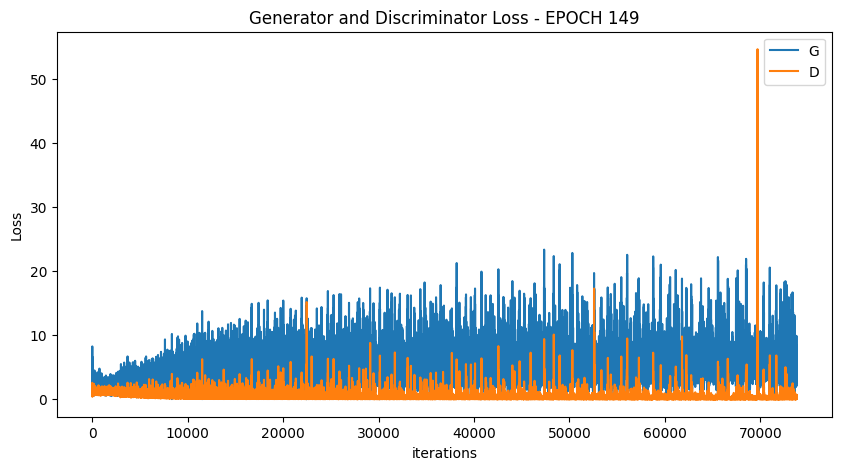

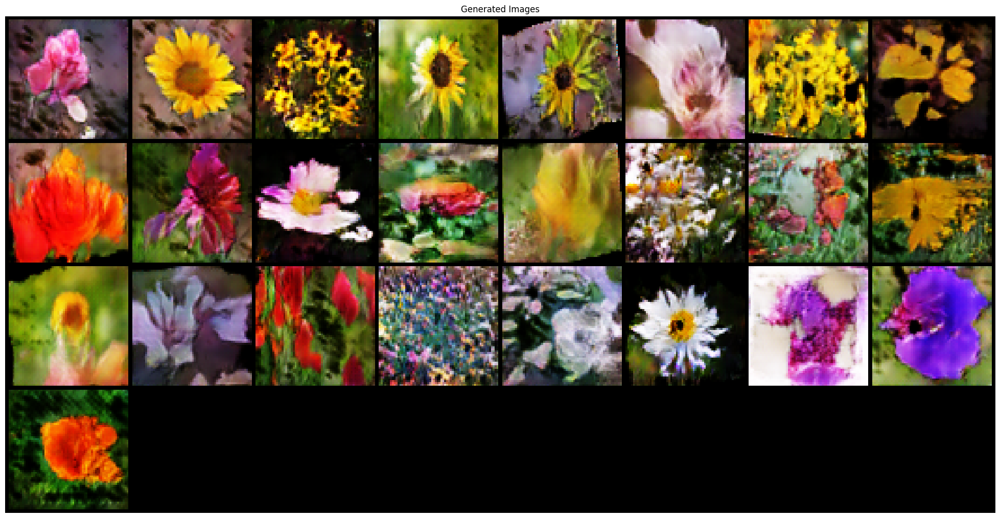

  0%|          | 0/492 [00:00<?, ?it/s]

[151/250] Loss_D: 0.0481 Loss_G: 5.4742 D(x): 0.9903 D(G(z)): 0.0354 / 0.0124


  0%|          | 0/492 [00:00<?, ?it/s]

[152/250] Loss_D: 0.2973 Loss_G: 5.3831 D(x): 0.8131 D(G(z)): 0.0012 / 0.0276


  0%|          | 0/492 [00:00<?, ?it/s]

[153/250] Loss_D: 0.1018 Loss_G: 5.6427 D(x): 0.9548 D(G(z)): 0.0341 / 0.0083


  0%|          | 0/492 [00:00<?, ?it/s]

[154/250] Loss_D: 0.0308 Loss_G: 6.0626 D(x): 0.9766 D(G(z)): 0.0065 / 0.0051


  0%|          | 0/492 [00:00<?, ?it/s]

[155/250] Loss_D: 0.0995 Loss_G: 6.9613 D(x): 0.9614 D(G(z)): 0.0334 / 0.0025


  0%|          | 0/492 [00:00<?, ?it/s]

[156/250] Loss_D: 0.0190 Loss_G: 4.7596 D(x): 0.9981 D(G(z)): 0.0168 / 0.0187


  0%|          | 0/492 [00:00<?, ?it/s]

[157/250] Loss_D: 0.1185 Loss_G: 4.2690 D(x): 0.9995 D(G(z)): 0.1047 / 0.0231


  0%|          | 0/492 [00:00<?, ?it/s]

[158/250] Loss_D: 0.0226 Loss_G: 6.3083 D(x): 0.9938 D(G(z)): 0.0157 / 0.0073


  0%|          | 0/492 [00:00<?, ?it/s]

[159/250] Loss_D: 0.0340 Loss_G: 5.8597 D(x): 0.9707 D(G(z)): 0.0034 / 0.0131


  0%|          | 0/492 [00:00<?, ?it/s]

[160/250] Loss_D: 0.5060 Loss_G: 5.4268 D(x): 0.8346 D(G(z)): 0.1745 / 0.0086


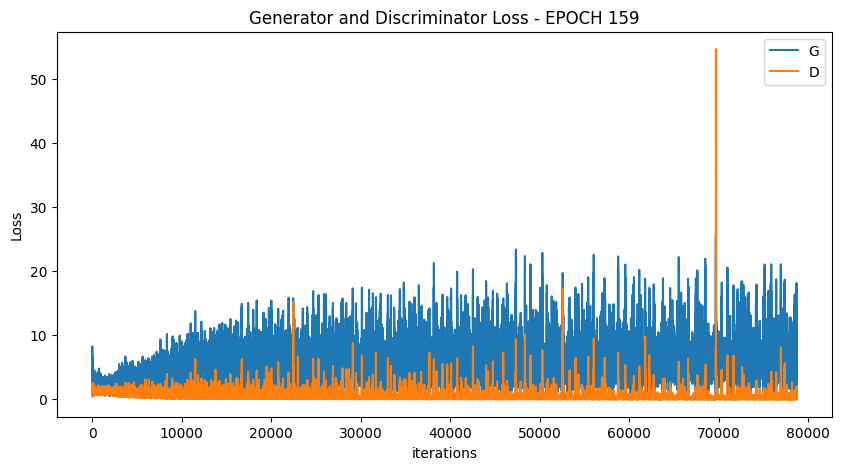

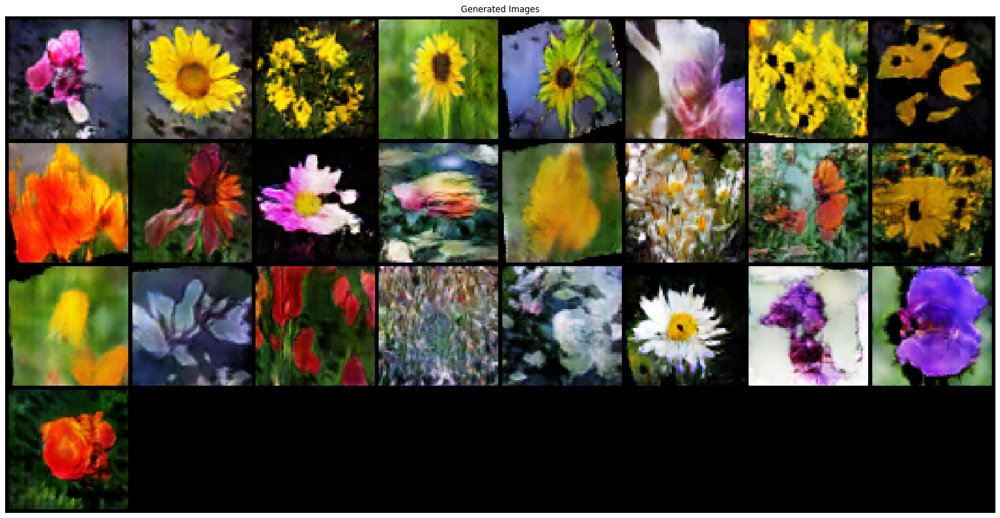

  0%|          | 0/492 [00:00<?, ?it/s]

[161/250] Loss_D: 0.0824 Loss_G: 6.2027 D(x): 0.9335 D(G(z)): 0.0065 / 0.0108


  0%|          | 0/492 [00:00<?, ?it/s]

[162/250] Loss_D: 0.2658 Loss_G: 8.1293 D(x): 0.9902 D(G(z)): 0.1280 / 0.0006


  0%|          | 0/492 [00:00<?, ?it/s]

[163/250] Loss_D: 0.0080 Loss_G: 8.3835 D(x): 0.9943 D(G(z)): 0.0023 / 0.0009


  0%|          | 0/492 [00:00<?, ?it/s]

[164/250] Loss_D: 0.0134 Loss_G: 6.0245 D(x): 0.9921 D(G(z)): 0.0052 / 0.0102


  0%|          | 0/492 [00:00<?, ?it/s]

[165/250] Loss_D: 0.4259 Loss_G: 4.9100 D(x): 0.7871 D(G(z)): 0.0040 / 0.0579


  0%|          | 0/492 [00:00<?, ?it/s]

[166/250] Loss_D: 0.0185 Loss_G: 7.0104 D(x): 0.9839 D(G(z)): 0.0017 / 0.0023


  0%|          | 0/492 [00:00<?, ?it/s]

[167/250] Loss_D: 0.0469 Loss_G: 5.3490 D(x): 0.9729 D(G(z)): 0.0166 / 0.0154


  0%|          | 0/492 [00:00<?, ?it/s]

[168/250] Loss_D: 0.0834 Loss_G: 6.4614 D(x): 0.9913 D(G(z)): 0.0657 / 0.0032


  0%|          | 0/492 [00:00<?, ?it/s]

[169/250] Loss_D: 0.0266 Loss_G: 6.0152 D(x): 0.9802 D(G(z)): 0.0058 / 0.0091


  0%|          | 0/492 [00:00<?, ?it/s]

[170/250] Loss_D: 0.0049 Loss_G: 7.2643 D(x): 0.9970 D(G(z)): 0.0018 / 0.0027


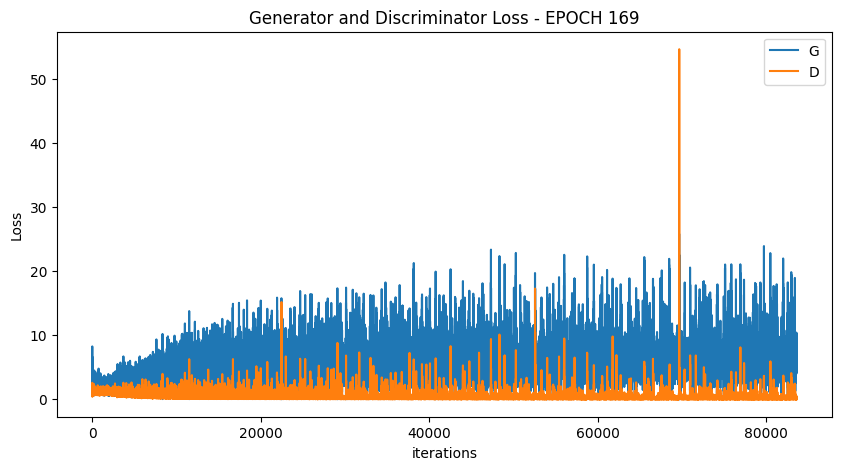

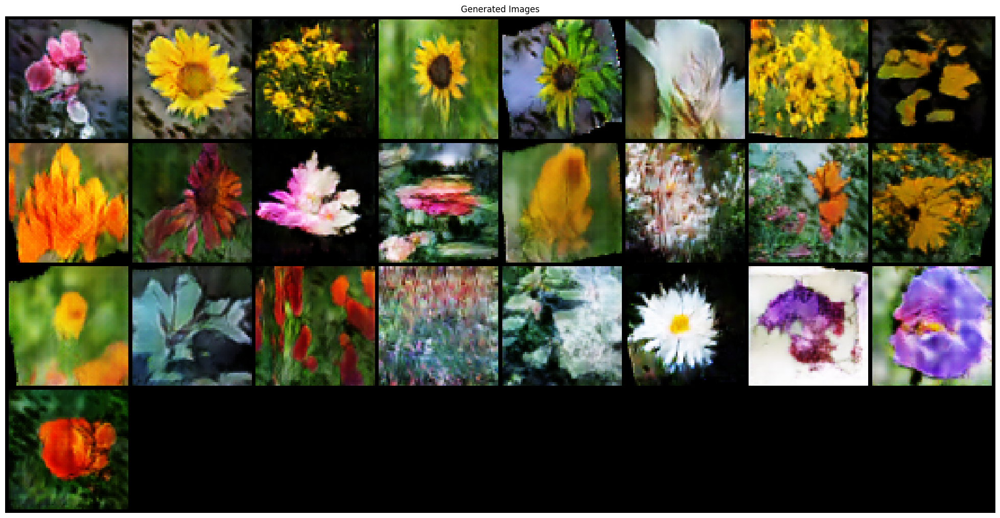

  0%|          | 0/492 [00:00<?, ?it/s]

[171/250] Loss_D: 0.0654 Loss_G: 6.4642 D(x): 0.9592 D(G(z)): 0.0127 / 0.0063


  0%|          | 0/492 [00:00<?, ?it/s]

[172/250] Loss_D: 0.0646 Loss_G: 6.3718 D(x): 0.9703 D(G(z)): 0.0299 / 0.0093


  0%|          | 0/492 [00:00<?, ?it/s]

[173/250] Loss_D: 0.0950 Loss_G: 6.5871 D(x): 0.9772 D(G(z)): 0.0403 / 0.0037


  0%|          | 0/492 [00:00<?, ?it/s]

[174/250] Loss_D: 0.1078 Loss_G: 8.5745 D(x): 0.9150 D(G(z)): 0.0033 / 0.0013


  0%|          | 0/492 [00:00<?, ?it/s]

[175/250] Loss_D: 0.0087 Loss_G: 7.2850 D(x): 0.9939 D(G(z)): 0.0025 / 0.0039


  0%|          | 0/492 [00:00<?, ?it/s]

[176/250] Loss_D: 0.1993 Loss_G: 9.0086 D(x): 1.0000 D(G(z)): 0.1356 / 0.0003


  0%|          | 0/492 [00:00<?, ?it/s]

[177/250] Loss_D: 0.0631 Loss_G: 5.1330 D(x): 1.0000 D(G(z)): 0.0583 / 0.0087


  0%|          | 0/492 [00:00<?, ?it/s]

[178/250] Loss_D: 0.0096 Loss_G: 7.0355 D(x): 0.9995 D(G(z)): 0.0089 / 0.0048


  0%|          | 0/492 [00:00<?, ?it/s]

[179/250] Loss_D: 0.0479 Loss_G: 7.9366 D(x): 0.9944 D(G(z)): 0.0377 / 0.0019


  0%|          | 0/492 [00:00<?, ?it/s]

[180/250] Loss_D: 0.3356 Loss_G: 4.1055 D(x): 0.8571 D(G(z)): 0.0278 / 0.0620


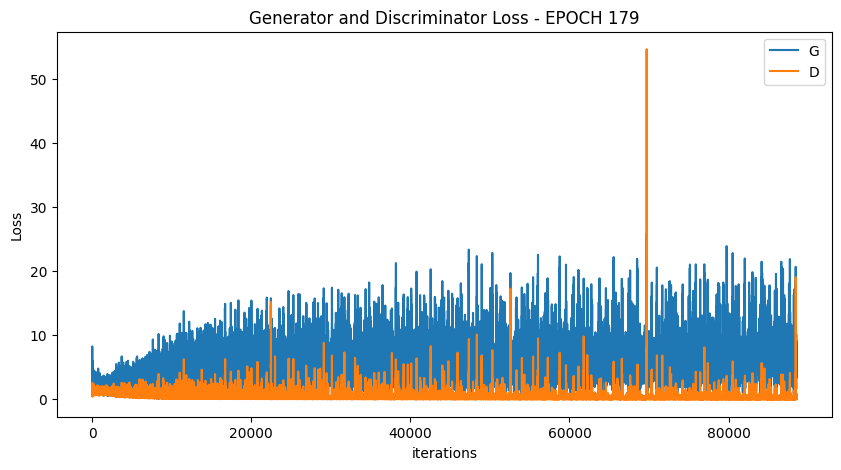

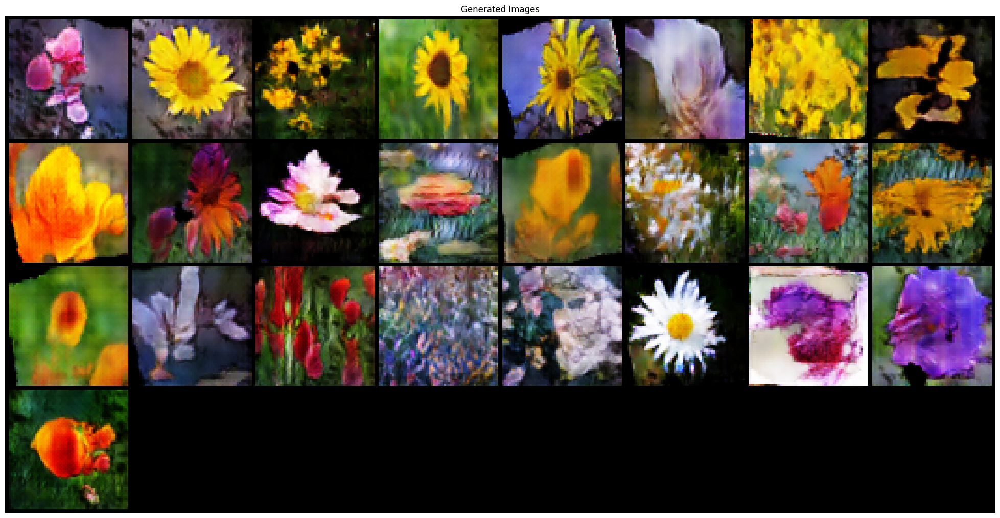

  0%|          | 0/492 [00:00<?, ?it/s]

[181/250] Loss_D: 0.0923 Loss_G: 6.7659 D(x): 0.9602 D(G(z)): 0.0346 / 0.0085


  0%|          | 0/492 [00:00<?, ?it/s]

[182/250] Loss_D: 0.0120 Loss_G: 6.7294 D(x): 0.9926 D(G(z)): 0.0045 / 0.0045


  0%|          | 0/492 [00:00<?, ?it/s]

[183/250] Loss_D: 0.0394 Loss_G: 9.4354 D(x): 0.9673 D(G(z)): 0.0025 / 0.0003


  0%|          | 0/492 [00:00<?, ?it/s]

[184/250] Loss_D: 0.5119 Loss_G: 3.4857 D(x): 0.7276 D(G(z)): 0.0006 / 0.1189


  0%|          | 0/492 [00:00<?, ?it/s]

[185/250] Loss_D: 0.0160 Loss_G: 5.6299 D(x): 0.9973 D(G(z)): 0.0128 / 0.0249


  0%|          | 0/492 [00:00<?, ?it/s]

[186/250] Loss_D: 0.0596 Loss_G: 5.7735 D(x): 0.9689 D(G(z)): 0.0253 / 0.0075


  0%|          | 0/492 [00:00<?, ?it/s]

[187/250] Loss_D: 0.0876 Loss_G: 4.9982 D(x): 0.9476 D(G(z)): 0.0205 / 0.0255


  0%|          | 0/492 [00:00<?, ?it/s]

[188/250] Loss_D: 2.1360 Loss_G: 17.3478 D(x): 0.9999 D(G(z)): 0.6260 / 0.0000


  0%|          | 0/492 [00:00<?, ?it/s]

[189/250] Loss_D: 0.0335 Loss_G: 6.4029 D(x): 0.9926 D(G(z)): 0.0242 / 0.0083


  0%|          | 0/492 [00:00<?, ?it/s]

[190/250] Loss_D: 0.2897 Loss_G: 9.1988 D(x): 0.9991 D(G(z)): 0.1817 / 0.0002


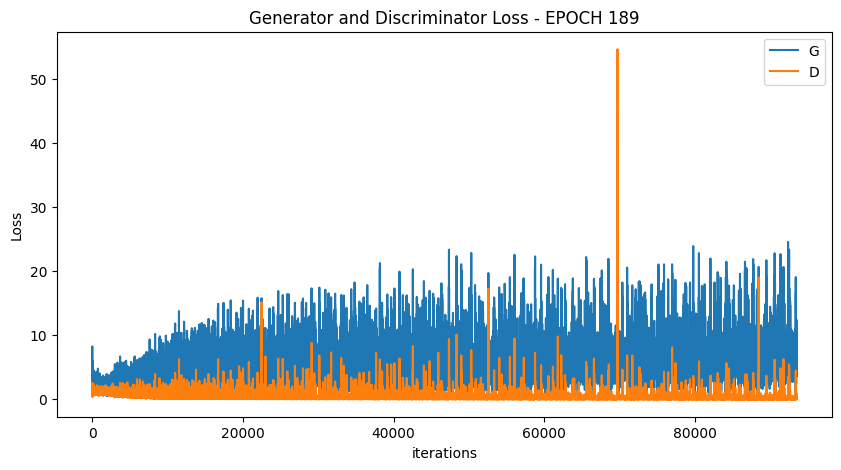

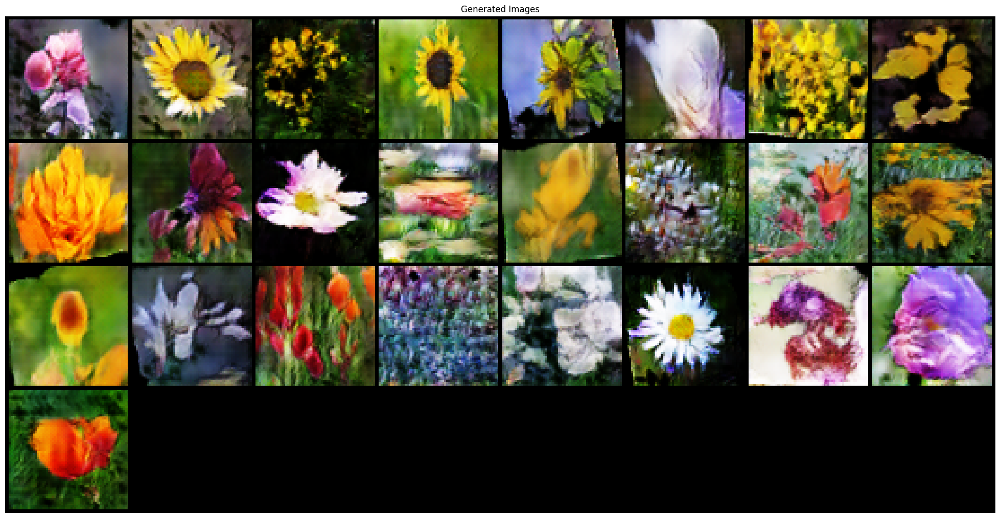

  0%|          | 0/492 [00:00<?, ?it/s]

[191/250] Loss_D: 0.0665 Loss_G: 8.0496 D(x): 0.9681 D(G(z)): 0.0009 / 0.0014


  0%|          | 0/492 [00:00<?, ?it/s]

[192/250] Loss_D: 0.0242 Loss_G: 7.3578 D(x): 0.9965 D(G(z)): 0.0191 / 0.0024


  0%|          | 0/492 [00:00<?, ?it/s]

[193/250] Loss_D: 0.0996 Loss_G: 7.1028 D(x): 0.9186 D(G(z)): 0.0018 / 0.0065


  0%|          | 0/492 [00:00<?, ?it/s]

[194/250] Loss_D: 0.0226 Loss_G: 8.1795 D(x): 0.9988 D(G(z)): 0.0179 / 0.0013


  0%|          | 0/492 [00:00<?, ?it/s]

[195/250] Loss_D: 0.0768 Loss_G: 5.6309 D(x): 0.9562 D(G(z)): 0.0266 / 0.0084


  0%|          | 0/492 [00:00<?, ?it/s]

[196/250] Loss_D: 0.0769 Loss_G: 5.7008 D(x): 0.9485 D(G(z)): 0.0084 / 0.0110


  0%|          | 0/492 [00:00<?, ?it/s]

[197/250] Loss_D: 0.0650 Loss_G: 5.4822 D(x): 0.9924 D(G(z)): 0.0522 / 0.0123


  0%|          | 0/492 [00:00<?, ?it/s]

[198/250] Loss_D: 0.0193 Loss_G: 7.5656 D(x): 0.9862 D(G(z)): 0.0050 / 0.0019


  0%|          | 0/492 [00:00<?, ?it/s]

[199/250] Loss_D: 0.0076 Loss_G: 8.2034 D(x): 0.9967 D(G(z)): 0.0042 / 0.0022


  0%|          | 0/492 [00:00<?, ?it/s]

[200/250] Loss_D: 0.1991 Loss_G: 4.1074 D(x): 0.8397 D(G(z)): 0.0117 / 0.0658


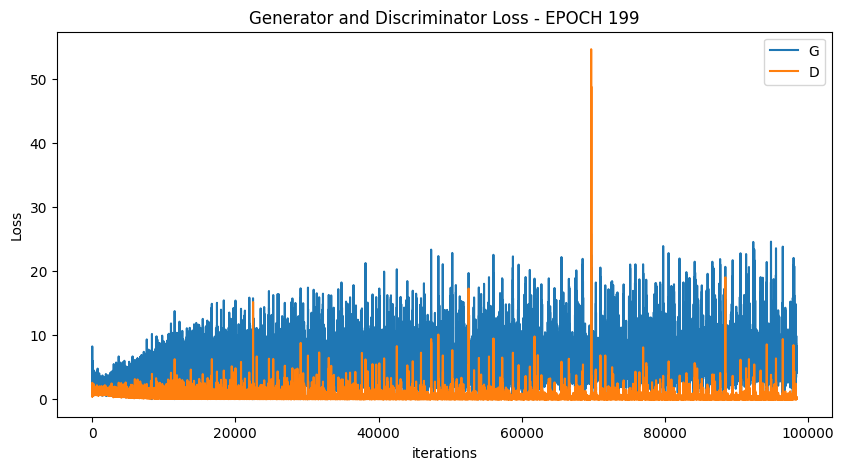

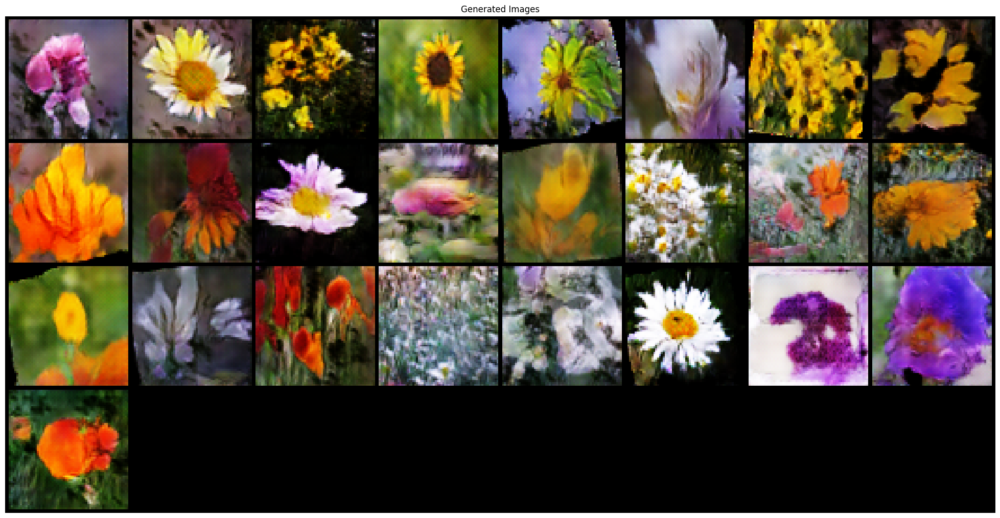

  0%|          | 0/492 [00:00<?, ?it/s]

[201/250] Loss_D: 0.0210 Loss_G: 8.5874 D(x): 0.9808 D(G(z)): 0.0009 / 0.0016


  0%|          | 0/492 [00:00<?, ?it/s]

[202/250] Loss_D: 0.2338 Loss_G: 5.9493 D(x): 0.8735 D(G(z)): 0.0148 / 0.0095


  0%|          | 0/492 [00:00<?, ?it/s]

[203/250] Loss_D: 0.0435 Loss_G: 6.4979 D(x): 0.9790 D(G(z)): 0.0197 / 0.0064


  0%|          | 0/492 [00:00<?, ?it/s]

[204/250] Loss_D: 0.2624 Loss_G: 10.5071 D(x): 0.9511 D(G(z)): 0.1034 / 0.0004


  0%|          | 0/492 [00:00<?, ?it/s]

[205/250] Loss_D: 0.1261 Loss_G: 6.6970 D(x): 0.9064 D(G(z)): 0.0124 / 0.0077


  0%|          | 0/492 [00:00<?, ?it/s]

[206/250] Loss_D: 0.0334 Loss_G: 6.1541 D(x): 0.9824 D(G(z)): 0.0139 / 0.0168


  0%|          | 0/492 [00:00<?, ?it/s]

[207/250] Loss_D: 0.1465 Loss_G: 8.2146 D(x): 0.9983 D(G(z)): 0.0538 / 0.0019


  0%|          | 0/492 [00:00<?, ?it/s]

[208/250] Loss_D: 0.4146 Loss_G: 9.4318 D(x): 0.9999 D(G(z)): 0.2778 / 0.0001


  0%|          | 0/492 [00:00<?, ?it/s]

[209/250] Loss_D: 0.0134 Loss_G: 5.7876 D(x): 0.9990 D(G(z)): 0.0122 / 0.0077


  0%|          | 0/492 [00:00<?, ?it/s]

[210/250] Loss_D: 0.0203 Loss_G: 8.1814 D(x): 0.9993 D(G(z)): 0.0184 / 0.0032


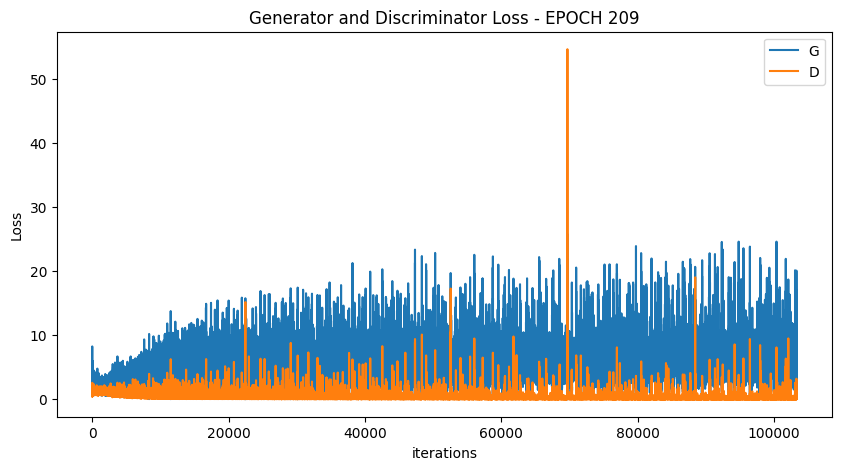

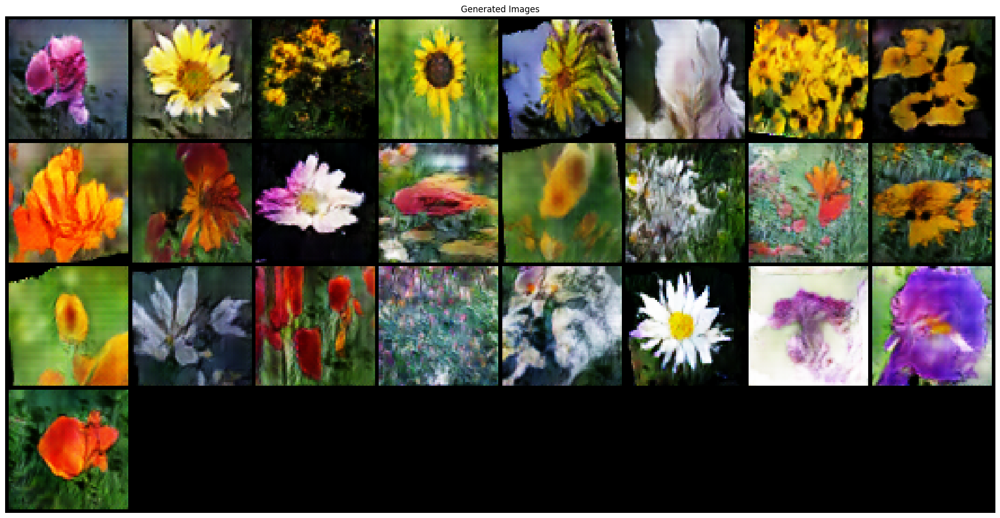

  0%|          | 0/492 [00:00<?, ?it/s]

[211/250] Loss_D: 0.0536 Loss_G: 7.3612 D(x): 0.9991 D(G(z)): 0.0400 / 0.0030


  0%|          | 0/492 [00:00<?, ?it/s]

[212/250] Loss_D: 0.0298 Loss_G: 6.7488 D(x): 0.9890 D(G(z)): 0.0178 / 0.0050


  0%|          | 0/492 [00:00<?, ?it/s]

[213/250] Loss_D: 0.0451 Loss_G: 6.5556 D(x): 0.9735 D(G(z)): 0.0156 / 0.0074


  0%|          | 0/492 [00:00<?, ?it/s]

[214/250] Loss_D: 1.4406 Loss_G: 11.2526 D(x): 1.0000 D(G(z)): 0.5899 / 0.0000


  0%|          | 0/492 [00:00<?, ?it/s]

[215/250] Loss_D: 0.1526 Loss_G: 5.3643 D(x): 0.8799 D(G(z)): 0.0089 / 0.0201


  0%|          | 0/492 [00:00<?, ?it/s]

[216/250] Loss_D: 0.0133 Loss_G: 8.2973 D(x): 0.9886 D(G(z)): 0.0018 / 0.0016


  0%|          | 0/492 [00:00<?, ?it/s]

[217/250] Loss_D: 0.1754 Loss_G: 6.5651 D(x): 0.9995 D(G(z)): 0.1326 / 0.0049


  0%|          | 0/492 [00:00<?, ?it/s]

[218/250] Loss_D: 0.0821 Loss_G: 6.6416 D(x): 0.9967 D(G(z)): 0.0690 / 0.0050


  0%|          | 0/492 [00:00<?, ?it/s]

[219/250] Loss_D: 0.7623 Loss_G: 10.8739 D(x): 0.9994 D(G(z)): 0.3521 / 0.0000


  0%|          | 0/492 [00:00<?, ?it/s]

[220/250] Loss_D: 0.1048 Loss_G: 6.8066 D(x): 0.9934 D(G(z)): 0.0706 / 0.0034


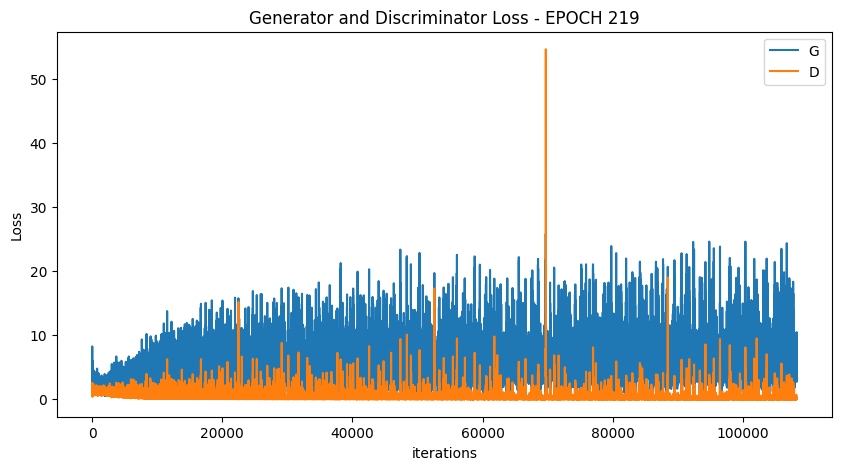

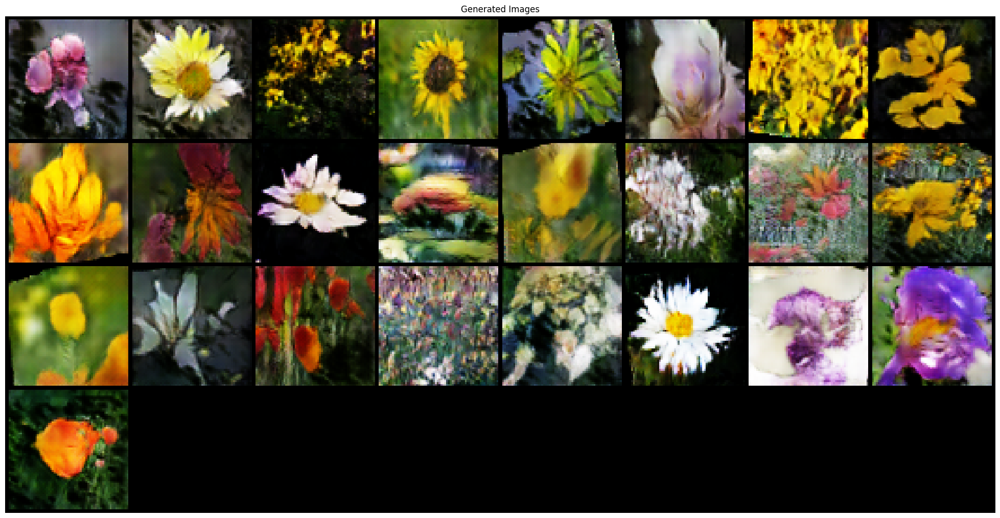

  0%|          | 0/492 [00:00<?, ?it/s]

[221/250] Loss_D: 0.0028 Loss_G: 8.8703 D(x): 0.9980 D(G(z)): 0.0008 / 0.0007


  0%|          | 0/492 [00:00<?, ?it/s]

[222/250] Loss_D: 0.4491 Loss_G: 3.3022 D(x): 0.7763 D(G(z)): 0.0668 / 0.1063


  0%|          | 0/492 [00:00<?, ?it/s]

[223/250] Loss_D: 0.1029 Loss_G: 6.1336 D(x): 0.9113 D(G(z)): 0.0044 / 0.0090


  0%|          | 0/492 [00:00<?, ?it/s]

[224/250] Loss_D: 0.0042 Loss_G: 6.7095 D(x): 0.9995 D(G(z)): 0.0037 / 0.0042


  0%|          | 0/492 [00:00<?, ?it/s]

[225/250] Loss_D: 0.0068 Loss_G: 6.5606 D(x): 0.9990 D(G(z)): 0.0057 / 0.0028


  0%|          | 0/492 [00:00<?, ?it/s]

[226/250] Loss_D: 0.0054 Loss_G: 7.4195 D(x): 0.9980 D(G(z)): 0.0033 / 0.0021


  0%|          | 0/492 [00:00<?, ?it/s]

[227/250] Loss_D: 0.2384 Loss_G: 5.5727 D(x): 0.8618 D(G(z)): 0.0044 / 0.0161


  0%|          | 0/492 [00:00<?, ?it/s]

[228/250] Loss_D: 0.0418 Loss_G: 8.8266 D(x): 0.9626 D(G(z)): 0.0019 / 0.0014


  0%|          | 0/492 [00:00<?, ?it/s]

[229/250] Loss_D: 0.1493 Loss_G: 8.6823 D(x): 0.9991 D(G(z)): 0.1196 / 0.0005


  0%|          | 0/492 [00:00<?, ?it/s]

[230/250] Loss_D: 0.1811 Loss_G: 8.1881 D(x): 0.9984 D(G(z)): 0.1006 / 0.0011


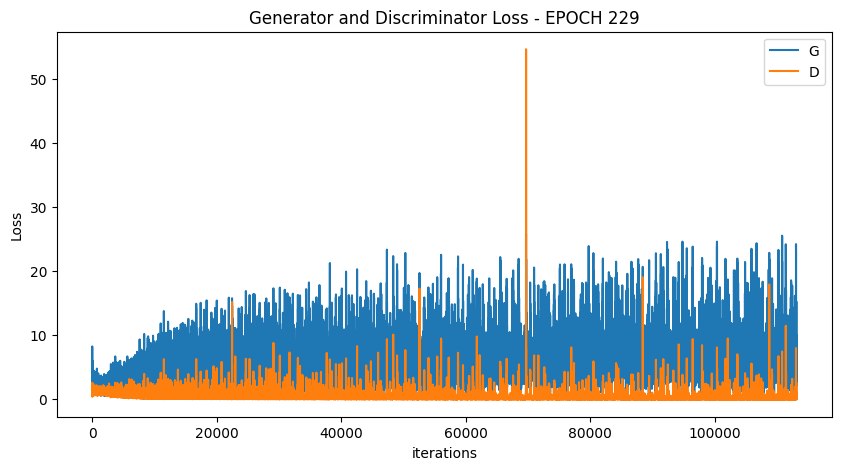

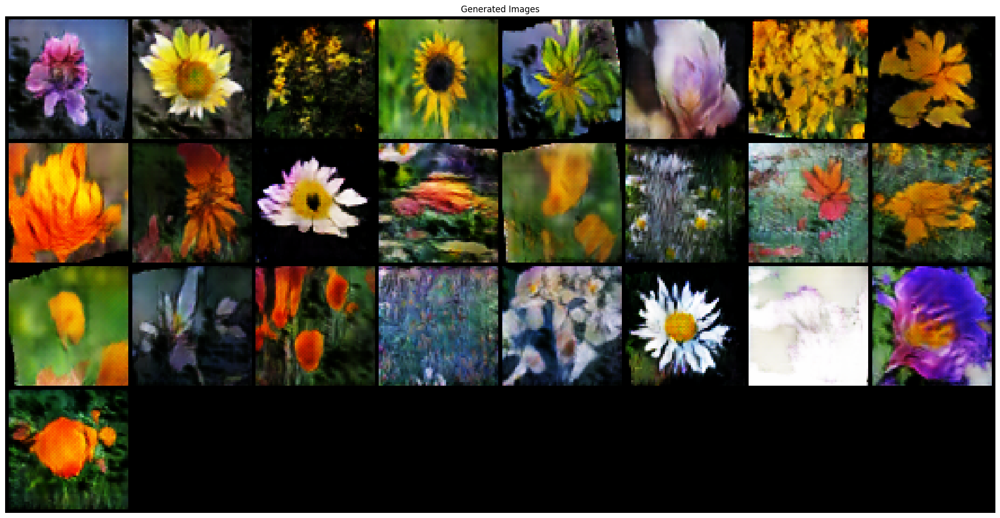

  0%|          | 0/492 [00:00<?, ?it/s]

[231/250] Loss_D: 1.1515 Loss_G: 14.8191 D(x): 1.0000 D(G(z)): 0.4871 / 0.0000


  0%|          | 0/492 [00:00<?, ?it/s]

[232/250] Loss_D: 0.0467 Loss_G: 6.3188 D(x): 0.9983 D(G(z)): 0.0402 / 0.0059


  0%|          | 0/492 [00:00<?, ?it/s]

[233/250] Loss_D: 0.3272 Loss_G: 7.9289 D(x): 0.9998 D(G(z)): 0.2267 / 0.0006


  0%|          | 0/492 [00:00<?, ?it/s]

[234/250] Loss_D: 0.1058 Loss_G: 7.1173 D(x): 0.9993 D(G(z)): 0.0731 / 0.0030


  0%|          | 0/492 [00:00<?, ?it/s]

[235/250] Loss_D: 0.0605 Loss_G: 6.4111 D(x): 0.9794 D(G(z)): 0.0305 / 0.0062


  0%|          | 0/492 [00:00<?, ?it/s]

[236/250] Loss_D: 0.1182 Loss_G: 7.2214 D(x): 0.9968 D(G(z)): 0.0866 / 0.0028


  0%|          | 0/492 [00:00<?, ?it/s]

[237/250] Loss_D: 0.0444 Loss_G: 6.6496 D(x): 0.9912 D(G(z)): 0.0322 / 0.0042


  0%|          | 0/492 [00:00<?, ?it/s]

[238/250] Loss_D: 0.0049 Loss_G: 7.1097 D(x): 0.9995 D(G(z)): 0.0044 / 0.0047


  0%|          | 0/492 [00:00<?, ?it/s]

[239/250] Loss_D: 0.2858 Loss_G: 9.3859 D(x): 1.0000 D(G(z)): 0.1927 / 0.0002


  0%|          | 0/492 [00:00<?, ?it/s]

[240/250] Loss_D: 0.8235 Loss_G: 3.5410 D(x): 0.5982 D(G(z)): 0.0004 / 0.1643


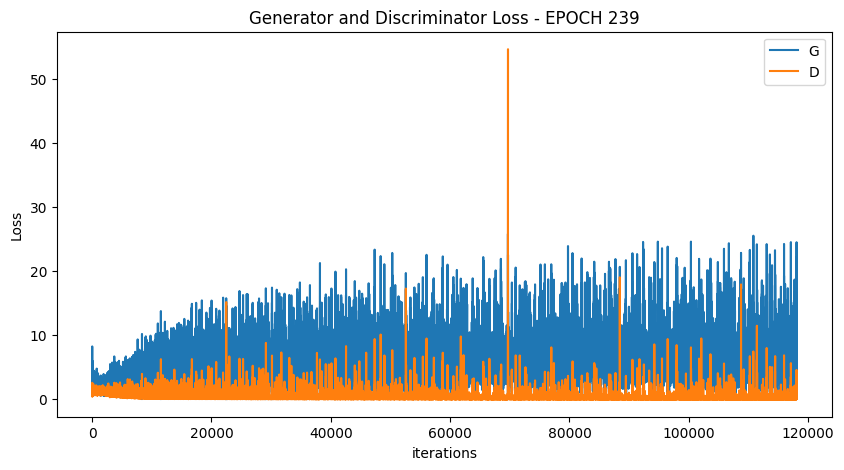

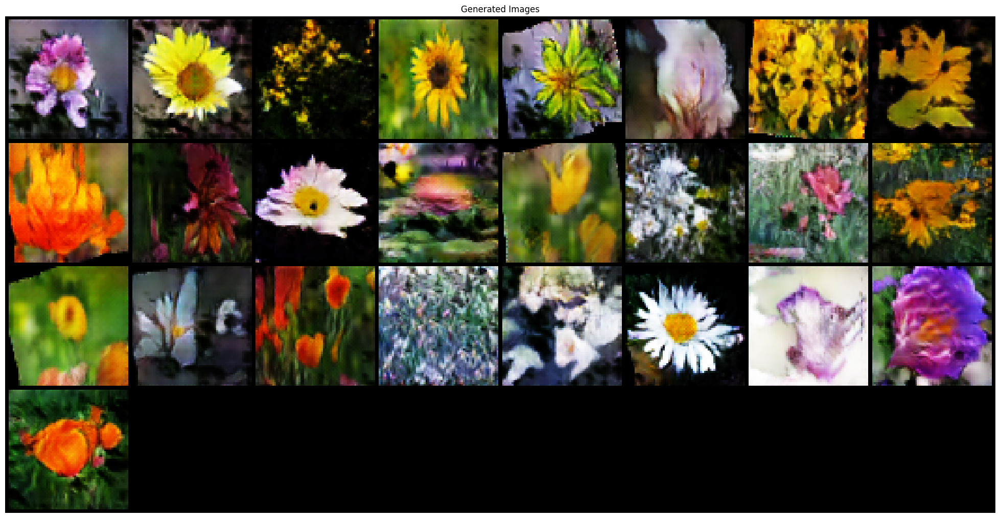

  0%|          | 0/492 [00:00<?, ?it/s]

[241/250] Loss_D: 0.0785 Loss_G: 6.8155 D(x): 0.9960 D(G(z)): 0.0608 / 0.0039


  0%|          | 0/492 [00:00<?, ?it/s]

[242/250] Loss_D: 0.4596 Loss_G: 7.0277 D(x): 0.7261 D(G(z)): 0.0001 / 0.0042


  0%|          | 0/492 [00:00<?, ?it/s]

[243/250] Loss_D: 0.1468 Loss_G: 6.5689 D(x): 0.9712 D(G(z)): 0.0860 / 0.0047


  0%|          | 0/492 [00:00<?, ?it/s]

[244/250] Loss_D: 0.0656 Loss_G: 7.8714 D(x): 0.9462 D(G(z)): 0.0030 / 0.0028


  0%|          | 0/492 [00:00<?, ?it/s]

[245/250] Loss_D: 0.0554 Loss_G: 8.2668 D(x): 0.9968 D(G(z)): 0.0425 / 0.0008


  0%|          | 0/492 [00:00<?, ?it/s]

[246/250] Loss_D: 0.1898 Loss_G: 5.6625 D(x): 0.8872 D(G(z)): 0.0281 / 0.0120


  0%|          | 0/492 [00:00<?, ?it/s]

[247/250] Loss_D: 0.0078 Loss_G: 7.3935 D(x): 0.9999 D(G(z)): 0.0076 / 0.0028


  0%|          | 0/492 [00:00<?, ?it/s]

[248/250] Loss_D: 0.0474 Loss_G: 5.3305 D(x): 0.9689 D(G(z)): 0.0137 / 0.0140


  0%|          | 0/492 [00:00<?, ?it/s]

[249/250] Loss_D: 0.0771 Loss_G: 5.8230 D(x): 0.9990 D(G(z)): 0.0617 / 0.0058


  0%|          | 0/492 [00:00<?, ?it/s]

[250/250] Loss_D: 0.0541 Loss_G: 6.7591 D(x): 0.9802 D(G(z)): 0.0280 / 0.0062


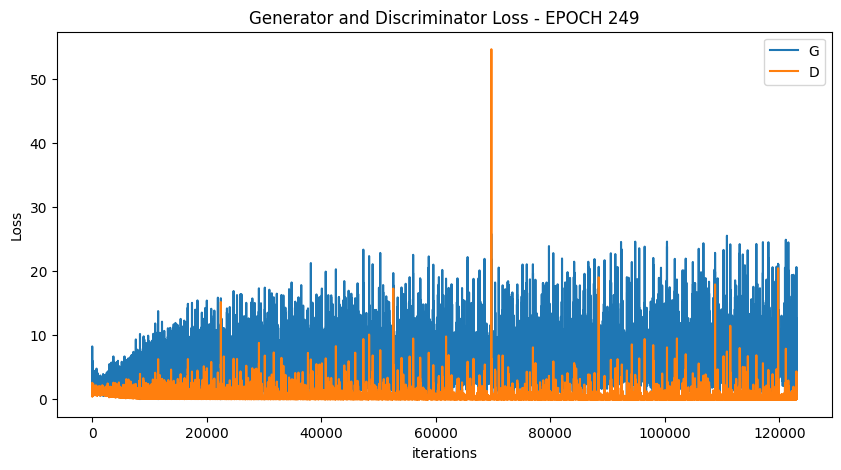

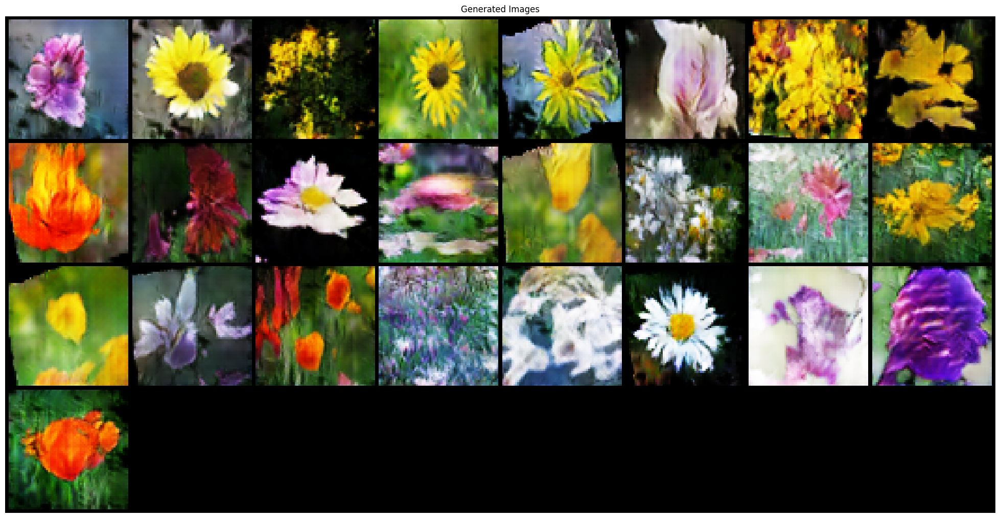

In [14]:
for epoch in range(epochs):
    start = time.time()
    for ii, (real_images, train_labels) in enumerate(tqdm(train_loader)):
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        netD.zero_grad()
        real_images = real_images.to(device)
        batch_size = real_images.size(0)
        labels_real = torch.full((batch_size, 1), 1.0, device=device)
        labels_fake = torch.full((batch_size, 1), 0.0, device=device)

        # Forward pass real batch through D
        output = netD(real_images)
        errD_real = criterion(output, labels_real)
        D_x = output.mean().item()

        # Generate fake images and calculate D's loss on them
        noise = torch.randn(batch_size, nz, 1, 1, device=device)
        fake = netG(noise)
        output = netD(fake.detach())  # Detach to avoid backprop through G
        errD_fake = criterion(output, labels_fake)
        D_G_z1 = output.mean().item()

        # Backpropagate and optimize D
        errD = errD_real + errD_fake
        errD.backward()
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        labels_real.fill_(1.0)  # Generator wants to fool discriminator, so labels are real for generator cost
        output = netD(fake)
        errG = criterion(output, labels_real)
        D_G_z2 = output.mean().item()

        # Backpropagate and optimize G
        errG.backward()
        optimizerG.step()

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

    epoch_time.append(time.time() - start)

    # Print statistics and plot images every epoch
    print('[%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f / %.4f'
          % (epoch + 1, epochs, errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

    # Optionally, show generated images
    if (epoch + 1) % 10 == 0:
        plot_loss (G_losses, D_losses, epoch)
        with torch.no_grad():
            generated_images = netG(fixed_noise).detach().cpu()
        plt.figure(figsize=(25, 25))
        plt.axis("off")
        plt.title("Generated Images")
        plt.imshow(np.transpose(vutils.make_grid(generated_images, padding=2, normalize=True), (1, 2, 0)))
        plt.show()

In [15]:
pip install pytorch-fid

Note: you may need to restart the kernel to use updated packages.


In [16]:
import os
from pytorch_fid import fid_score

In [18]:
if not os.path.exists('../output_images'):
    os.mkdir('../output_images')
    
im_batch_size = 50
n_images=10000

for i_batch in tqdm(range(0, n_images, im_batch_size)):
    gen_z = torch.randn(im_batch_size, nz, 1, 1, device=device)
    gen_images = netG(gen_z)
    images = gen_images.to("cpu").clone().detach()
    images = images.numpy().transpose(0, 2, 3, 1)
    for i_image in range(gen_images.size(0)):
        save_image(gen_images[i_image, :, :, :], os.path.join('../output_images', f'image_{i_batch+i_image:05d}.png'))

/tmp/ipykernel_24/2441337517.py:7: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i_batch in tqdm(range(0, n_images, im_batch_size)):


  0%|          | 0/200 [00:00<?, ?it/s]

In [19]:
path_to_dataset1 =  '../output_images'
path_to_dataset2 = '..output/preprocessed/images'

# Step 4: Verify dataset integrity by loading a few images
def verify_images(path):
    for root, _, files in os.walk(path):
        for file in files:
            try:
                img = Image.open(os.path.join(root, file))
                img.verify()  # Verify that it is, in fact, an image
            except (IOError, SyntaxError) as e:
                print(f'Bad file: {os.path.join(root, file)}')

print("Verifying dataset 1...")
verify_images(path_to_dataset1)
print("Verifying dataset 2...")
verify_images(path_to_dataset2)

# Step 5: Calculate FID score with a smaller batch size and on CPU to avoid GPU memory issues
fid_value = fid_score.calculate_fid_given_paths(
    [path_to_dataset1, path_to_dataset2], 
    batch_size=10,  # Smaller batch size
    #device='cpu',  # Use CPU to avoid GPU memory issues
    dims=2048,
    device = 'cuda'
)
print('FID:', fid_value)


Verifying dataset 1...
Verifying dataset 2...


Downloading: "https://github.com/mseitzer/pytorch-fid/releases/download/fid_weights/pt_inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/pt_inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:00<00:00, 312MB/s]
100%|██████████| 1574/1574 [01:06<00:00, 23.64it/s]


FID: 90.75832408818559


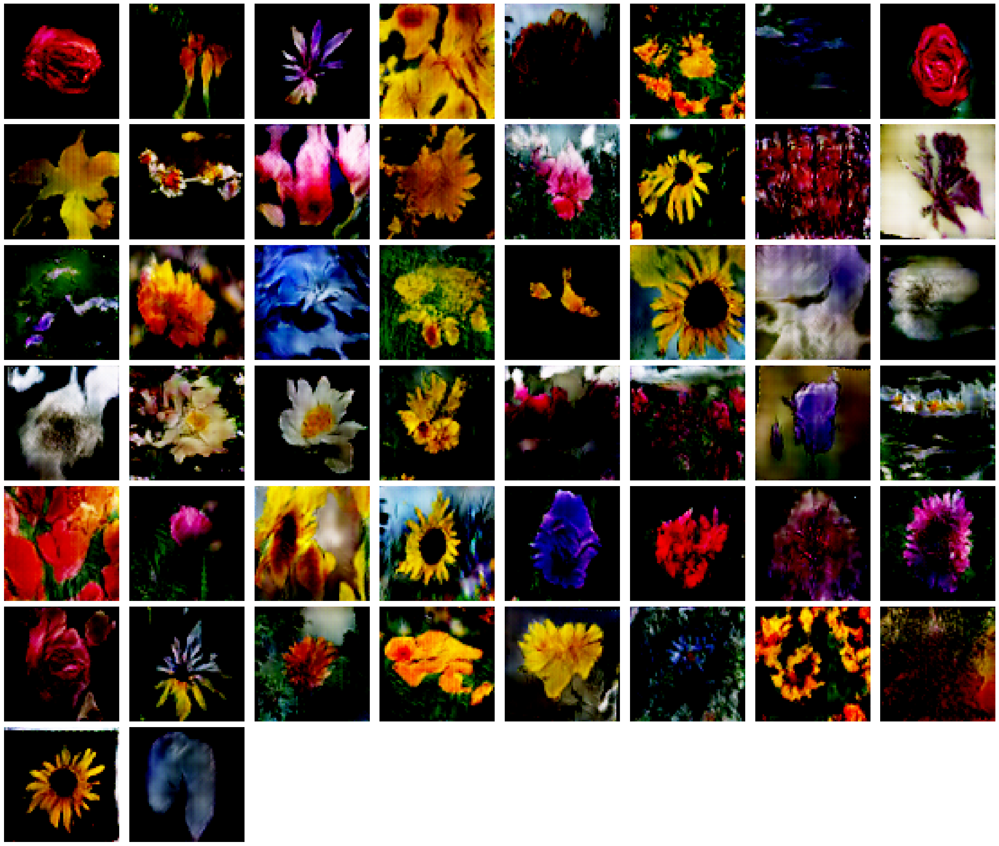

In [20]:
import matplotlib.pyplot as plt

# Assuming 'images' is a list or array of images you want to display
fig = plt.figure(figsize=(25, 45))

# Display 10 images from each class
for i, img in enumerate(images[:100]):
    ax = fig.add_subplot(15, 8, i + 1, xticks=[], yticks=[])
    ax.imshow(img)
    ax.axis('off')  # Turn off the axis for a cleaner look

plt.tight_layout(pad=1.0)  #to prevent overlap
plt.show()


In [21]:
print (">> average EPOCH duration = ", np.mean(epoch_time))

>> average EPOCH duration =  47.364654089927676
